## DELE CA2 PART B : PENDULUM REINFORCEMENT LEARNING

Team Members : Dario Prawara Teh Wei Rong (2201858) | Lim Zhen Yang (2214506)


### BACKGROUND RESEARCH & ANALYSIS

Reinforcement Learning (RL) is a type of machine learning that focuses on training agents to make decisions in an environment by maximizing a reward signal. The roots of RL actually stems all the way back to the 1930s and 40s, where Skinner presented his experimental research on the behaviour of animals. He described the concept of "operant conditioning" which involved manipulating the consequences of an animal's behaviour, in order to change the likelihood that the behaviour would occur in the future. (Skinner, 1991) 

For example, one of his most famous experiments was the "Skinner Box" experiment, which studied operant conditioning. In this experiment, Skinner placed a rat in a box with a lever and a food dispenser, and demonstrated how the rat learned to press the lever to receive a food reward. This experiment helped Skinner develop his theory of operant conditioning, which states that behavior is shaped by consequences (rewards and punishments) that follow the behavior.

### HOW REINFORCEMENT LEARNING WORKS

> Any goal can be formalized as the outcome of maximizing a cumulative reward - Hado van Hasselt, DeepMind.com

Each of the algorithms revolve around an agent that plays in an environment. There are a few different types of components that an agent can contain. These are:
- Agent State
- Policy
- Value Function Estimate - Optional
- Model - Optional

![](https://i.imgur.com/6zl5wnT.png)<br />
<em>Image Credits: deepmind.com</em>

### KEY CHALLENGES IN REINFORCEMENT LEARNING


#### <u>Exploration-Exploitation</u>
When an agent is initialized and put into a new environment, the optimal actions it should take are essentially random, in that the agent does not possess any knowledge of what to do, or what the task to tackle even is. Only when it interacts with environment, gain knowledge from data and learn the optimal actions, does it improve. However, "reliance on data" could possibly lead to two different scenarios. (Wang, Zariphopoulou and Zhou, 2019)

>**Exploitation**: The agent learns that a certain action returns some reward. Because the goal is to maximize the total reward, the agent then continuous to maximize the reward by repeatedly exploiting this specific knowledge or performing this move. As one can imagine, if the agent has not ultimately visited a large enough action space, this knowledge may lead to a suboptimal policy (Wiering, 1999).
<br />

>**Exploration**: Take actions that currently don't possess the maximum expected reward, to learn more about the environment and realize better options for the future. However, the agent focusing solely on learning new knowledge, will lead to a potential waste of resource, time and opportunities. 

Thus, the agent must learn to **balance the trade-off** between the exploring and exploiting, to learn the actions that will ultimately lead to the maximum optimal policy.

What are some approaches to tackle this issue? The simplest way is to randomly choose; every move there is a 50% chance to explore, and the other 50% to exploit. One may then realize that infact, a much smarter move would be have some sort of parameter **epsilon** $\epsilon$, that controls the **probability to exploit**, with the probability to explore being 1 - $\epsilon$. By doing this, $\epsilon$ can **now be tuned** to maximize the policy, which empirically is much. (Bather, 1990)

#### <u>Delayed Reward</u>
Usually, unlike in Supervised Learning, agents do not get immediate feedback on a per action basis. Rather, the reward system is attributed towards a sequence of actions. This means that agents must be considerate of the possibility that taking greedy approaches (essentially trying to retrieve immediate rewards) may result in less future reward.

### APPLICATIONS & USES OF REINFORCEMENT LEARNING


#### <u>What are the uses of RL?</u>
It can be used to optimize decision making in systems where the decision maker does not have complete information about the system or the consequences of its actions. Additionally, it may be used to control systems that are difficult to model completely under mathematical equations, such as robots that must operate in uncertain environments. RL can also be used in control systems like robotics, games and autonomous systems.

For example, Boston Dynamics has used reinforcement learning to train its robots to balance and walk on rough terrain, such as rocks or uneven surfaces. The robots **receive rewards for maintaining balance and penalties for falling over**, allowing them to learn to walk more stably and efficiently over time. 

![](https://i.imgur.com/DSB9tJv.jpg)<br />
<em>Boston Dynamics Robot (Image Credits: bostondynamics.com)</em>

RL has proven to be a powerful tool for Boston Dynamics in their development of advanced robots, allowing them to perform complex and dynamic tasks in real-world environments with greater stability and robustness. (Pineda-Villavicencio, Ugon and Yost, 2018)

### OUR PROJECT OBJECTIVE

Before we begin, let us take a look at our project's objective.

> Using OpenAI Gym, apply a **suitable modification of deep Q-network (DQN) architecture to the problem**. The model must exert some **appropriate torque on the pendulum** to balance it.

### BACKGROUND INFORMATION

Pendulum is part of the five classic control environments. They are stochastic in terms of their initial state, within a given range.

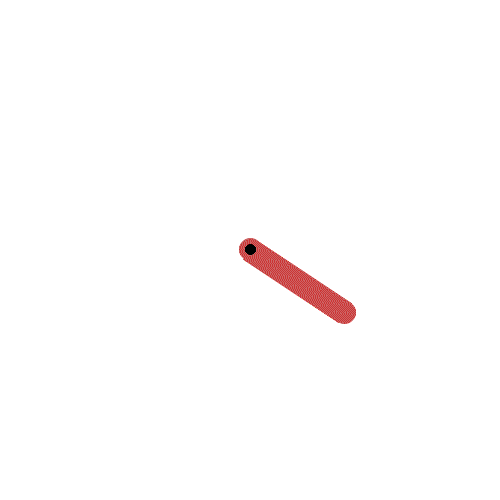

The inverted pendulum swingup problem is based on the classic problem in control theory. The system consists of a **pendulum attached at one end to a fixed point**, and the other end being free. The pendulum starts in a random position and the **goal is to apply torque on the free end to swing it into an upright position**, with its center of gravity right above the fixed point.

<u>**Action Space** - The pendulum can only perform one action (torque).<br></u>
- A `ndarray` with shape `(1,)` representing the torque applied to free end of the pendulum with a range from -2.0 to 2.0.

<u>**Observation Space** - There are a total of 3 distinct components in the observation space.<br></u>
- Coordinates of the Pendulum in x = cos(theta)
- Coordinates of the Pendulum in y = sin(theta)
- Angular Velocity of the Pendulum 

<u>**Rewards Granted** - For each time step, the reward :<br></u>
- is decreased as the pendulum deviates further from the upright position (closer to θ = 0).
- is decreased as the pendulum's angular velocity increases (faster movement).
- is decreased as the pendulum tilts away from the vertical position.

An episode is considered successful if it achieves a minimum cumulative reward of **-16.2736044 (the minimum possible reward)** or a maximum reward of 0, representing the pendulum being perfectly upright and balanced (no torque applied).

The pendulum starts at a random angle in [-pi, pi] and a random angular velocity in [-1, 1] and the **episode truncates at 200 time steps.**

### INITIALIZING MODULES AND LIBRARIES

- Import necessary libraries for pre-processing, data exploration, feature engineering and model evaluation.

- Some libraries used include pytorch, numpy, matplotlib, and gym.

In [1]:
# Import the necessary modules and libraries

# Gym and Environment Handling
import gym

# Numerical and Visualization Libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib import animation, rc
import seaborn as sns
from torchinfo import summary

# Display and Visualization
from IPython import display as ipythondisplay
from pyvirtualdisplay.display import Display
from IPython.display import clear_output, display

# PyTorch for Neural Networks and Optimization
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torch.distributions as distributions
from torch.distributions import Normal

# Utility and Miscellaneous
import os
import random
import copy
import datetime
from collections import deque, namedtuple

# Hyperparameter tuning
from ray import tune, train
from ray.train import Checkpoint, session
from ray.tune.schedulers import ASHAScheduler
from functools import partial
import tempfile

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\ray\data\__init__.py:4: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources._vendor.packaging.version import parse as parse_version
c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\pkg_resources\__init__.py:2868: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('mpl_toolkits')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\pkg_resources\__init__.py:2868: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptoo

### PERFORM CHECK FOR GPU

- Ensure GPU can be found when using torch.cuda.is_available().
- If returned `True`, it means that the GPU is working as expected for PyTorch.

In [2]:
torch.cuda.is_available()

True

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


### SETTING UTILITY FUNCTIONS AND CLASSES

- Before beginning our analysis, we will first define some utility functions and classes that will be used later for analysis or evaluation of our models.
- Some utility functions used will be `plot_agent_performance`, which is used to plot the charts to visualize changes in reward obtained.

In [44]:
# Function to plot the performance of the model over time
def plot_agent_performance(scores, average_reward, model_name="Random Agent"):
    """
    Plots the performance of an agent.

    Parameters:
    scores (list): A list of scores representing the agent's performance in each episode.
    average_reward (float): The average reward across all episodes.
    model_name (str): The name of the model/agent.
    """
    # Creating subplots: 1 row, 2 columns
    plt.figure(figsize=(15, 6))

    # First subplot: Reward over Episodes
    plt.subplot(1, 2, 1) 
    plt.plot(scores, label='Reward per Episode')
    plt.axhline(y=average_reward, color='r', linestyle='-', label='Average Reward')
    plt.xlabel('Episode')
    plt.ylabel('Total Reward')
    plt.title(f'Reward over Episodes for {model_name}')
    plt.legend()

    # Second subplot: Histogram of Rewards
    plt.subplot(1, 2, 2)  
    plt.hist(scores, bins=20, alpha=0.7)
    plt.axvline(x=average_reward, color='r', linestyle='-', label='Average Reward')
    plt.xlabel('Total Reward')
    plt.ylabel('Frequency')
    plt.title(f'Distribution of Rewards for {model_name}')
    plt.legend()

    # Display the subplots
    plt.tight_layout()
    plt.show()
    
# Creating an animation function
def create_animation(frames, filename=None):
    rc("animation", html="jshtml")
    fig = plt.figure()
    plt.axis("off")
    im = plt.imshow(frames[0], animated=True)

    def updatefig(i):
        im.set_array(frames[i])
        return im,

    animationFig = animation.FuncAnimation(fig, updatefig, frames=len(frames), interval=len(frames)/10, blit=True, repeat=False)
    ipythondisplay.display(ipythondisplay.HTML(animationFig.to_html5_video()))
    if filename != None:
        animationFig.save(filename, writer='imagemagick')
    return animationFig

# Function to test agent weights
def test_agent(agent, type):
    env = gym.make('Pendulum-v1', g=9.81)
    frames = []

    state = env.reset()
    done = False
    cumulative_reward = 0  # Initialize cumulative reward

    while not done:
        if type == 'SAC':
            action, _ = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([action])
        else:
            action = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([action])

        cumulative_reward += reward  # Accumulate reward
        state = state_prime

        screen = env.render(mode='rgb_array')
        frames.append(screen)

    env.close()

    print(f'Test reward: {cumulative_reward}')  # Print cumulative reward
    create_animation(frames)
        
# Initialize the RunningCalc class
class RunningCalc:
    class Node:
        def __init__(self, val):
            self.val = val
            self.next = None

    def __init__(self, limit=10):
        self.head = None
        self.tail = None
        self.count = 0
        self.limit = limit
        self.total = 0

    def add(self, val):
        self.count += 1
        if self.count > self.limit:
            self.total -= self.head.val
            self.head = self.head.next
            self.count -= 1

        if self.head is None and self.tail is None:
            self.head = self.Node(val)
            self.tail = self.head
        else:
            newNode = self.Node(val)
            self.tail.next = newNode
            self.tail = newNode
        self.total += val

    def calc(self):
        return self.total
    
# Initalize the Tracker class to track rewards over time
class Tracker:
    def __init__(self):
        self.running = {}
        self.reward = {}
        self.success = {}
        self.name = None

    def add(self, name, running, reward, success_rate):
        if name in self.running.keys():
            self.running[name].append(running)
        else:
            self.running[name] = [running]

        if name in self.reward.keys():
            self.reward[name].append(reward)
        else:
            self.reward[name] = [reward]

        if name in self.success.keys():
            self.success[name].append(success_rate)
        else:
            self.success[name] = [reward]

        print(f"{name} | Running 200 Reward: {running} | Reward: {reward} | Running Success Rate: {success_rate} ")
        
        def plot(self, name, metric):
            fig = plt.figure()
            fig.suptitle(f"{name} | {metric}")
            ax = fig.subplots()
            if metric == 'success':
                ax.plot(self.success[name])
            else:
                ax.plot([200 for i in range(len(self.reward[name]))], label='Solve', linestyle='--')
                ax.plot(self.reward[name], label='Reward', color=sns.color_palette('pastel')[0])
                ax.plot(self.running[name], label='Running', color=sns.color_palette('pastel')[1], linestyle='--')
                plt.legend()

        def plot_all(self, metric):
            fig = plt.figure()
            ax = fig.subplots()
            ax.set_xlabel("Episodes (in 20s)")

            if metric == 'success':
                fig.suptitle("All Success")
                score = self.success
                for i, name in enumerate(list(sorted(self.reward.keys()))):
                    ax.plot(self.success[name], label=f'{name}', color=sns.color_palette('Paired')[1 + i * 2])
                ax.set_ylabel("Success Rate")
                plt.legend()

            elif metric == 'reward':
                fig.suptitle("All Rewards")
                first = list(self.reward.keys())[0]
                ax.plot([200 for i in range(len(self.reward[first]))], label='Solve', linestyle='--')
                for i, name in enumerate(list(sorted(self.reward.keys()))):
                    ax.plot(self.running[name], label=f'{name}', color=sns.color_palette('Paired')[1 + i * 2])
                    ax.plot(self.reward[name], color=sns.color_palette('Paired')[0 + i * 2], linestyle='--')
                ax.set_ylabel("Episode Reward")
                plt.legend()

### SETTING CHART CUSTOMIZATIONS FOR EDA 

- Before loading the pendulum environment from OpenAI Gym, we will be setting chart customizations in Seaborn to ensure a consistent and uniformed layout for our charts in this notebook.

In [5]:
# Change theme of charts
sns.set_theme(style='darkgrid')

# Change font of charts
sns.set(font='Century Gothic')

# Variable for color palettes
color_palette = sns.color_palette('muted')

### LOADING THE PENDULUM ENVIRONMENT

- We will be using the OpenAI Gym environment under Classic Control to make the Pendulum-v1 environment.
- To load the environment / animation, we will make use of Matplotlib's animation function and ipythondisplay.

To visualize what the animation looks like, we will be displaying the environment by running **200 time steps** for the pendulum using the provided `gym.make("Pendulum-v1")` import statement.

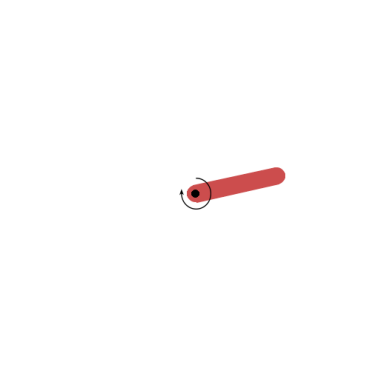

In [6]:
# Setting up the environment
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 200 time steps
frames = []
for i in range(200):
    action = env.action_space.sample()
    obs, reward, done, info = env.step(action)
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)

### INFORMATION ON THE PENDULUM COORDINATE SYSTEM

To implement the pendulum's dynamic equations, we will be utilizing the pendulum's coordinate system as shown below :

- `x-y` : cartesian coordinates of the pendulum's end in meters.
- `theta` : angle in radians.
- `tau` : torque in Nm. Defined as positive counter-clockwise.

### EXPLORATORY DATA ANALYSIS

First, we will conduct some simple exploratory data analysis (EDA) of the pendulum environment, allowing us to better understand the different actions and how they affect the pendulum's movement. Some things we are looking at will include :

- Observation Space Analysis
- Action Space Analysis
- Testing the Actions for the Pendulum

**OBSERVATION SPACE ANALYSIS**

- Based on the results, we can see that as stated in the background information, there are a total of 3 observation spaces for the pendulum.
- For `obs_low`, the values -1, -1, -8 represent the smallest possible values for each of the 3 dimensions, which are the x-coord, y-coord and angular velocity. (Same for `obs_high` with the values 1, 1, 8).

In [7]:
# Finding the minimum and maximum allowable values for each dimension of observation
obs_low = env.observation_space.low
obs_high = env.observation_space.high

print('Number of Observation Space: ', env.observation_space.shape)
print("Observation Space Low:", obs_low)
print("Observation Space High:", obs_high)

Number of Observation Space:  (3,)
Observation Space Low: [-1. -1. -8.]
Observation Space High: [1. 1. 8.]


**ACTION SPACE ANALYSIS**

- From our analysis, we see that the type of action space is continuous, with an action range of values from -2.0 to 2.0.
- As for the action shape, it is a single floating-point number (scalar) and are represented as 32-bit floating point numbers.

In [8]:
print('Number of Actions: ', env.action_space)

Number of Actions:  Box(-2.0, 2.0, (1,), float32)


**TESTING ACTIONS AND ITS EFFECTS ON THE PENDULUM**

Now, we will be looking into how each action can affect the pendulum. In the case of the pendulum, there are no discrete actions (meaning that the actions the pendulum can perform are infinite). Hence, we have **selected just 5 types of actions the pendulum could possibly make** and will be looking more into these specific actions for our EDA :

- Zero Torque
- Positive Maximum Torque (2.0)
- Negative Maximum Torque (-2.0)
- Gradual Increase in Torque
- Gradual Decrease in Torque

**ACTION 1 : ZERO TORQUE**

- We see that by applying zero torque, there is no external force applied to the pendulum, hence there is limited movement by the pendulum and will tend to stabilize in a downward position over time.
- The pendulum tends to stabilize in a downward position due to gravitational force, which affects its ability to gain rewards or maintain a specific upright position as encouraged by the reward system.

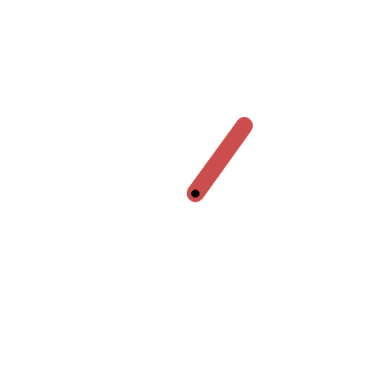

In [9]:
# Zero Torque
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 300 time steps
frames = []
for i in range(300):
    obs, reward, done, info = env.step([0.0])
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)


**ACTION 2 : POSITIVE TORQUE [2.0]**

- We see that with the maximum positive torque applied, it exerts the highest possible force where the pendulum will swing to the right then left (from its downward position).
- The positive torque helps the pendulum gain more angular momentum, but reduces stability of the pendulum around the upright position hence will result in lower rewards within the environment.

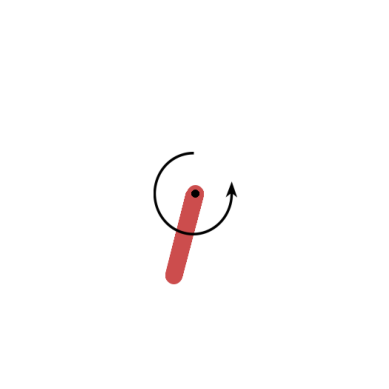

In [10]:
# Positive Torque
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 300 time steps
frames = []
for i in range(300):
    obs, reward, done, info = env.step([2.0])
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)

**ACTION 3 : NEGATIVE TORQUE [-2.0]**

- We see that with the maximum negative torque applied, it exerts the highest possible force where the pendulum will swing to the left then right (from its downward position).
- The negative torque helps the pendulum gain more angular momentum, but reduces stability of the pendulum around the upright position hence will result in lower rewards within the environment.

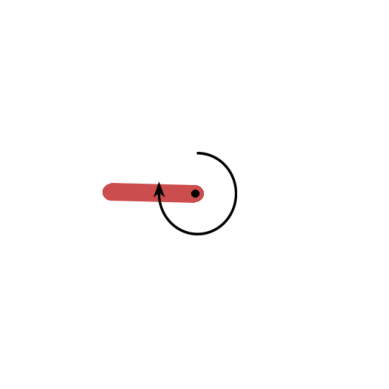

In [11]:
# Negative Torque
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 300 time steps
frames = []
for i in range(300):
    obs, reward, done, info = env.step([-2.0])
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)

**ACTION 4 : GRADUAL INCREASE IN TORQUE**

- We see that a gradual increase in torque allows for exploration of a broader stability landscape, observing how the pendulum responds to rising forces and identifying stability regions.
- The gradual increase in torque leads to a systematic rise in the force applied to the pendulum. This incrementally alters the pendulum's behavior, potentially causing wider swings or movements in the opposite direction to its natural hanging position.

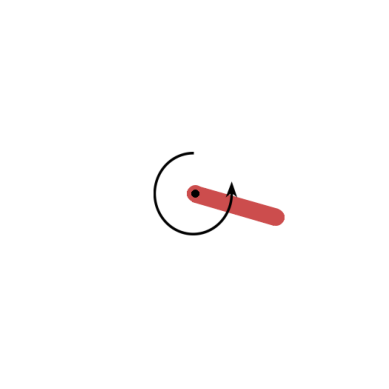

In [12]:
# Gradual Increase in Torque
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 300 time steps
frames = []
for i in range(300):
    obs, reward, done, info = env.step([-2.0 + (i * 0.08)])
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)

**ACTION 5 : GRADUAL DECREASE IN TORQUE**

- We see that a gradual decrease in torque explores stability concerning diminishing forces, potentially observing how the pendulum's movement changes as force reduces.
- The gradual decrease in torque systematically reduces the applied force. This decrement may gradually slow down the pendulum's movement or bring it closer to the natural downward position, which could aid in stability but limit exploration for more optimal strategies.

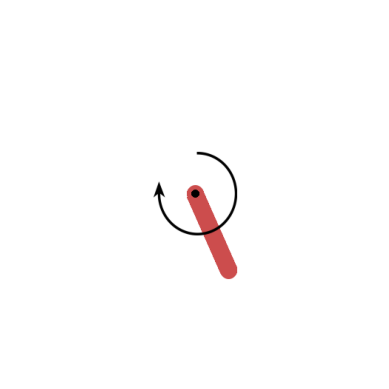

In [13]:
# Gradual Decrease in Torque
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)
env.reset()

# Defining the frames for 300 time steps
frames = []
for i in range(300):
    obs, reward, done, info = env.step([2.0 - (i * 0.08)])
    screen = env.render(mode='rgb_array')
    frames.append(screen)
    if done:
        break

env.close()
create_animation(frames)

**SUMMARY ANALYSIS OF TORQUE MOVEMENTS**

- We found that applying torque to the pendulum triggers substantial changes in its swinging behavior. High positive torque leads to forceful swings away from the natural downward position, resulting in decreased stability and penalties within the reward system. Conversely, negative torque slows movement in the opposite direction, potentially aiding stability, yet limited effectiveness incurs penalties due to deviations from the desired position. 

- This could indicate that lower torque may provide higher rewards, as it encourages stability in the pendulum's movement.

- Moreover, the reward system penalizes excessive movement, high velocities, and deviations from the desired stable state caused by high torque, resulting in reduced overall rewards. However, gradual changes in torque offer opportunities for systematic exploration, aiding in learning and potentially optimizing strategies for balancing the pendulum while minimizing the penalties incurred in the rewards system.

### MODEL DEVELOPMENT & EXPLORATION

Upon gathering insights from our EDA, we will now be proceeding to build and test a few reinforcement learning models to help balance the pendulum by exerting an appropriate level of torque. 

We will be testing with the following models :

- Random Action Model (Baseline Model)
- Simple Deep Q Network (DQN)
- Enhanced Deep Q Network (Improved Model) 
- Double Deep Q Network (DDQN)
- Soft Actor-Critic Network (SAC)

**In this RL analysis, we will be diving deeper into DQN-related architectures compared to other models to demonstrate its viability in solving the Pendulum task.**

### MODEL 1 : RANDOM ACTION MODEL - BASELINE

For random action model, it is a baseline as it operates by making decisions solely based on random selection from the available action space, and does not take in any considerations related to the environment's state or learning strategies.

This model will serve as a fundamental benchmark for us to evaluate the performance of more advanced models later on, such as Deep Q Network.

**CREATING AN AGENT THAT TAKES RANDOM ACTIONS**

Due to the possibility that the pendulum's episode may go on forever, we will set a fixed limit to the number of steps per episode for the pendulum at 200, to prevent the episode from running indefinitely.
We will be setting our number of episodes to 800 to give us a benchmark of how well our next few models should perform.

In [6]:
# Create the Gym environment for Pendulum with specified gravity and render mode
env = gym.make('Pendulum-v1', g=9.81)
env.action_space.seed(42)

# Initialize an array to store scores for visualization
total_rewards = []
frames = []

# Define the maximum number of episodes and steps per episode
MAX_EPISODES = 800
MAX_STEP_PER_EPISODE = 200

# Loop through the episodes using a for loop
for i in range(MAX_EPISODES):
    state = env.reset()
    total_reward = 0
    done = False
    start_time = datetime.datetime.now()

    # Loop through the maximum steps per episode
    for step in range(MAX_STEP_PER_EPISODE):
        action = env.action_space.sample() # Select a random action from the action space
        state, reward, done, info = env.step(action) # Apply the action and observe the result
        total_reward += reward

        if step % 30 == 0 and total_reward > -50:
            screen = env.render(mode='rgb_array')
            frames.append(screen)

        if done:
            break
            
    elapsed_time = datetime.datetime.now() - start_time
    if i % 10 == 0:
        print('Episode {:>4} | Total Reward: {:>8.2f} | Elapsed: {}'.format(i, total_reward, elapsed_time))
    total_rewards.append(total_reward)

# Close the environment
env.close()

Episode    0 | Total Reward: -1802.22 | Elapsed: 0:00:00.411252
Episode   10 | Total Reward: -1321.27 | Elapsed: 0:00:00.015025
Episode   20 | Total Reward: -1291.68 | Elapsed: 0:00:00.015692
Episode   30 | Total Reward:  -992.26 | Elapsed: 0:00:00.015252
Episode   40 | Total Reward: -1534.34 | Elapsed: 0:00:00.015068
Episode   50 | Total Reward: -1617.21 | Elapsed: 0:00:00.015047
Episode   60 | Total Reward: -1170.23 | Elapsed: 0:00:00.013512
Episode   70 | Total Reward: -1198.94 | Elapsed: 0:00:00.014853
Episode   80 | Total Reward: -1304.78 | Elapsed: 0:00:00.015785
Episode   90 | Total Reward:  -903.80 | Elapsed: 0:00:00.014683
Episode  100 | Total Reward:  -886.82 | Elapsed: 0:00:00.013750
Episode  110 | Total Reward:  -894.23 | Elapsed: 0:00:00.013363
Episode  120 | Total Reward:  -755.78 | Elapsed: 0:00:00.019042
Episode  130 | Total Reward:  -917.89 | Elapsed: 0:00:00.015532
Episode  140 | Total Reward: -1167.00 | Elapsed: 0:00:00.014530
Episode  150 | Total Reward: -1189.97 | 

**VISUALIZING THE PERFORMANCE OF RANDOM AGENT MODEL**

- From our baseline agent, we note that it performs random actions, hence none of them got close to 0 (or above 0). 
- It is also clear that there is no clear learning happening as there is no AI model learning the patterns from the random agent model. Hence, the results obtained are erratic with no visible improvement. 
- From our results, we can see that for the baseline model, the best episode is 157, with a score of -586.06. This score simply indicates that the pendulum failed to balance, hence this model is not good enough to solve the Pendulum task.

Performance Statistics for the Random Agent:
--------------------------------------------
Best Episode   : 61
Average Reward : -1219.34
Median Reward  : -1179.79
Maximum Reward : -728.41
Minimum Reward : -1830.10


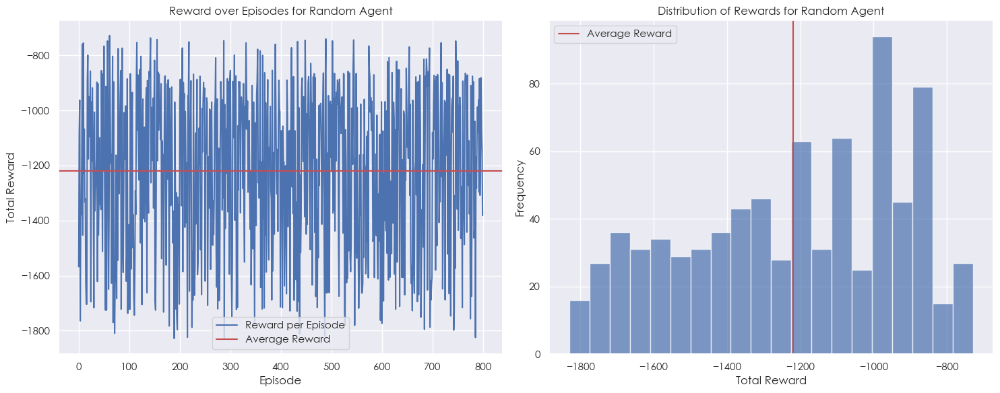

In [ ]:
# Calculating statistical measures
average_reward = np.mean(total_rewards)
median_reward = np.median(total_rewards)
max_reward = np.max(total_rewards)
min_reward = np.min(total_rewards)

# Identifying the best episode
best_episode_index = np.argmax(total_rewards) 

# Neatly formatted output
print("Performance Statistics for the Random Agent:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(total_rewards, average_reward, model_name="Random Agent")

**VISUALIZING THE PENDULUM ANIMATION FOR THE RANDOM ACTION MODEL**

- Now, we will be looking at the pendulum's animation for the random action model and how it moves.

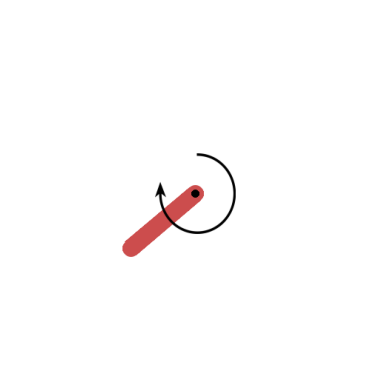

In [ ]:
create_animation(frames)

### MODEL 2 : SIMPLE DEEP Q NETWORK (DQN)

DQN (Deep Q-Network) is a reinforcement learning algorithm that combines Q-Learning with deep neural networks to estimate the Q-value function. The goal of DQN is to find a policy that maximizes the expected cumulative reward in an environment, by using the neural network to approximate the Q-value for each possible action in a given state. This allows DQN to scale to high-dimensional state spaces and solve more complex problems than traditional Q-Learning methods.

In reinforcement learning, the Q-value function represents the expected cumulative reward from taking a certain action in a certain state and following a specific policy thereafter. DQN uses a neural network to approximate the Q-value function and make decisions about which action to take in each state. The network is trained on a dataset of state-action-reward transitions generated by interacting with the environment. The training process updates the network weights so that the estimated Q-values for each action become more accurate over time.

One key innovation of DQN is the use of experience replay, which is a technique for storing and reusing previously observed state-action-reward transitions to decorrelate the samples and improve the stability of the learning process. Another important aspect of DQN is the use of target networks, which are separate networks that are used to stabilize the training of the primary network. The target network's weights are updated less frequently than the primary network's weights, which helps prevent overfitting and stabilize the learning process.

**INITALIZING AND CREATING THE REPLAYBUFFER CLASS**

- Here, before defining the model architecture, we will be defining the `ReplayBuffer` class, which serves as a memory storage system in RL tasks.
- It is designed to store and manage past experiences (transitions of an agent interacting with its environment. By creating a ReplayBuffer, it allows for the efficient storage and retrieval of these experiences, ensuring that the agent learns from a diverse set of historical interactions.

In [28]:
class ReplayBuffer:
    def __init__(self, buffer_limit):
        self.buffer = deque(maxlen=buffer_limit)

    def put(self, transition):
        self.buffer.append(transition)

    def sample(self, n):
        mini_batch = random.sample(self.buffer, n)
        s_lst, a_lst, r_lst, s_prime_lst, done_mask_lst = [], [], [], [], []

        for transition in mini_batch:
            s, a, r, s_prime, done = transition
            s_lst.append(s)
            a_lst.append([a])
            r_lst.append([r])
            s_prime_lst.append(s_prime)
            done_mask = 0.0 if done else 1.0
            done_mask_lst.append([done_mask])

        s_batch = torch.tensor(s_lst, dtype=torch.float)
        a_batch = torch.tensor(a_lst, dtype=torch.float)
        r_batch = torch.tensor(r_lst, dtype=torch.float)
        s_prime_batch = torch.tensor(s_prime_lst, dtype=torch.float)
        done_batch = torch.tensor(done_mask_lst, dtype=torch.float)

        return s_batch, a_batch, r_batch, s_prime_batch, done_batch

    def size(self):
        return len(self.buffer)

**SETTING UP THE MODEL ARCHITECTURE FOR THE SIMPLE DQN MODEL**

- As DQN Model is typically used for discrete action spaces, we will be discretizing the continuous action space for the Pendulum task for this variation of DQN.
- Later on, we will also explore other variations of DQN to see how our adjustments will affect the model's performance.
- For this model architecture, we will be training it on 1000 episodes and evaluate how the reward changes.

In [99]:
# Defining the QNetwork class for the DQN Agent
class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, q_lr):
        super(QNetwork, self).__init__()

        self.fc_1 = nn.Linear(state_dim, 64)
        self.fc_2 = nn.Linear(64, 32)
        self.fc_out = nn.Linear(32, action_dim)
        
        self.lr = q_lr
        self.optimizer = optim.Adam(self.parameters(), lr=self.lr)
        
    def forward(self, x):
        q = F.leaky_relu(self.fc_1(x))
        q = F.leaky_relu(self.fc_2(q))
        q = self.fc_out(q)
        return q

# Creating a class for the DQN Agent
class DQNAgent:
    def __init__(self):
        self.state_dim     = 3
        self.action_dim    = 9  
        self.lr            = 0.01
        self.gamma         = 0.98
        self.tau           = 0.01
        self.epsilon       = 1.0
        self.epsilon_decay = 0.98
        self.epsilon_min   = 0.001
        self.buffer_size   = 100000
        self.batch_size    = 200
        self.memory        = ReplayBuffer(self.buffer_size)
        self.Q        = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target.load_state_dict(self.Q.state_dict())
        
    def choose_action(self, state):
        random_number = np.random.rand()
        maxQ_action_count = 0
        if self.epsilon < random_number:
            with torch.no_grad():
                action = float(torch.argmax(self.Q(state)).numpy())
                real_action = (action - 4) / 4
                maxQ_action_count = 1
        else:
            action = np.random.choice([n for n in range(9)])
            real_action = (action - 4) / 2
            
        return action, real_action, maxQ_action_count
    
    def calc_target(self, mini_batch):
        s, a, r, s_prime, done = mini_batch
        with torch.no_grad():
            q_target = self.Q_target(s_prime).max(1)[0].unsqueeze(1)
            target = r + self.gamma * done * q_target
        return target
    
    def train_agent(self):
        mini_batch = self.memory.sample(self.batch_size)
        s_batch, a_batch, r_batch, s_prime_batch, done_batch = mini_batch
        a_batch = a_batch.type(torch.int64)
        td_target = self.calc_target(mini_batch)

        # QNetwork training 
        Q_a = self.Q(s_batch).gather(1, a_batch)
        q_loss = F.smooth_l1_loss(Q_a, td_target)
        self.Q.optimizer.zero_grad()
        q_loss.mean().backward()
        self.Q.optimizer.step()

        # QNetwork Soft Update
        for param_target, param in zip(self.Q_target.parameters(), self.Q.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)

In [100]:
def train_DQNAgent():
    # Initalize the DQN Agent and related variables required
    agent = DQNAgent() 
    env = gym.make('Pendulum-v1', g=9.81)
    episodes = 800
    total_rewards = []
    frames = []
    no_of_steps = []
    success_count = 0
    best_episode = 0 
    best_reward = float('-inf')

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        maxQ_action_count = 0
        start_time = datetime.datetime.now()
        
        while not done:
            action, real_action, count = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([real_action])
            agent.memory.put((state, action, reward, state_prime, done))

            score += reward
            maxQ_action_count += count
            state = state_prime

            if maxQ_action_count % 100 == 0 and score > -50:
                screen = env.render(mode='rgb_array')
                frames.append(screen)

            if agent.memory.size() > 1000: 
                agent.train_agent()

        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200
        total_rewards.append(score)
        no_of_steps.append(maxQ_action_count)
        
        if score > best_reward:
            best_reward = score
            best_episode = episode
            
        # Saving the Models
        save_folder = "DQN"
        if not os.path.exists(save_folder):
            os.makedirs(save_folder)

        if episode == best_episode:
            model_Q = os.path.join(save_folder, "DQN" + str(episode) + ".pt")
            torch.save(agent.Q.state_dict(), model_Q)
                
        if episode % 10 == 0:
            elapsed_time = datetime.datetime.now() - start_time
            print('Episode {:>4} | Total Reward: {:>8.2f} | MaxQ_Action_Count:{:>5} | Epsilon: {:>4.4f} | Elapsed: {}'.format(episode, score, maxQ_action_count, agent.epsilon, elapsed_time))   
            
        if agent.epsilon > agent.epsilon_min:
            agent.epsilon *= agent.epsilon_decay

    env.close()

    return {
        'total_rewards': total_rewards,
        'no_of_steps': no_of_steps,
        'success_count': success_count,
        'frames': frames
    }

DQN_results = train_DQNAgent()

Episode    0 | Total Reward: -1442.58 | MaxQ_Action_Count:    0 | Epsilon: 1.0000 | Elapsed: 0:00:00.581677
Episode   10 | Total Reward:  -875.69 | MaxQ_Action_Count:   34 | Epsilon: 0.8171 | Elapsed: 0:00:00.584059
Episode   20 | Total Reward:  -894.80 | MaxQ_Action_Count:   66 | Epsilon: 0.6676 | Elapsed: 0:00:00.685368
Episode   30 | Total Reward:  -889.94 | MaxQ_Action_Count:   91 | Epsilon: 0.5455 | Elapsed: 0:00:00.568242
Episode   40 | Total Reward:  -379.12 | MaxQ_Action_Count:  124 | Epsilon: 0.4457 | Elapsed: 0:00:00.567993
Episode   50 | Total Reward:  -490.62 | MaxQ_Action_Count:  132 | Epsilon: 0.3642 | Elapsed: 0:00:00.650391
Episode   60 | Total Reward:  -376.69 | MaxQ_Action_Count:  143 | Epsilon: 0.2976 | Elapsed: 0:00:00.580481
Episode   70 | Total Reward:  -373.07 | MaxQ_Action_Count:  154 | Epsilon: 0.2431 | Elapsed: 0:00:00.584176
Episode   80 | Total Reward:  -124.28 | MaxQ_Action_Count:  162 | Epsilon: 0.1986 | Elapsed: 0:00:00.567040
Episode   90 | Total Reward:

**VISUALIZING THE PERFORMANCE OF SIMPLE DQN MODEL**

- From our Simple DQN Model, we can see that the agent performed significantly better than the Random Action baseline model as there is visible improvement in the rewards obtained by the DQN model. This improvement indicates that the agent is learning effectively from its experiences and is gradually refining its policy to better address the task at hand, which is to balance the pendulum upright vertically. 

**HOW WILL WE IMPROVE THIS MODEL'S PERFORMANCE?**

- In the next section, we will be attempting to refine the action space by adjusting the number of discrete action spaces. We will also be looking at adjusting the learning rate and epsilon value, since our goal is to maintain the pendulum's state over time.
- Aside from the above, we will manually tweak the neural network's architecture to see if adjusting the filters or adding more layers can lead to improved performance.

Performance Statistics for the Simple DQN Model:
--------------------------------------------
Best Episode   : 138
Average Reward : -347.25
Median Reward  : -252.25
Maximum Reward : -1.52
Minimum Reward : -1775.87


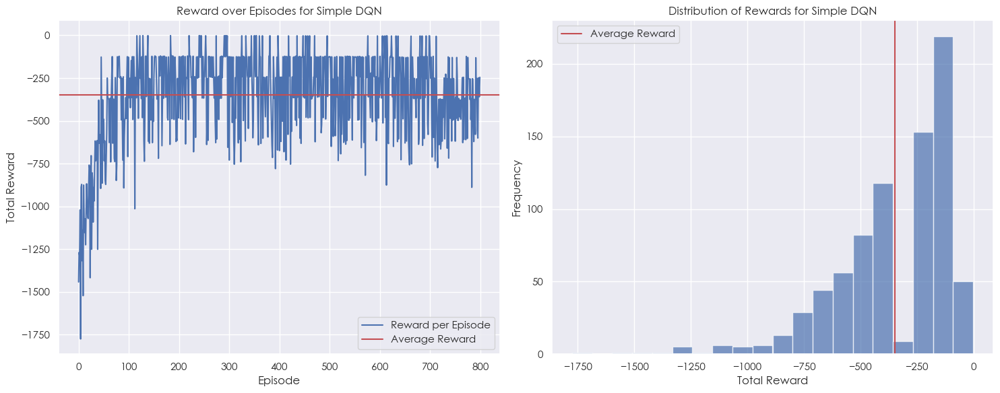

In [101]:
# Calculating statistical measures
average_reward = np.mean(DQN_results['total_rewards'])
median_reward = np.median(DQN_results['total_rewards'])
max_reward = np.max(DQN_results['total_rewards'])
min_reward = np.min(DQN_results['total_rewards'])

# Identifying the best episode
best_episode_index = np.argmax(DQN_results['total_rewards']) 

# Printing the Statistics
print("Performance Statistics for the Simple DQN Model:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(DQN_results['total_rewards'], average_reward, model_name="Simple DQN")

**VIEWING THE MODEL ARCHITECTURE AND PENDULUM ANIMATION**

- Now, we will be looking at the model architecture used to train the DQN agent using the `.eval()` function for PyTorch.
- We will also be viewing the animation of the pendulum's movement and visualize how the pendulum behaves.

In [103]:
# Load and view the model's architecture used for DQN
trained_model = DQNAgent()
trained_model.Q.load_state_dict(torch.load("DQN/DQN138.pt"))
trained_model.Q.eval()

QNetwork(
  (fc_1): Linear(in_features=3, out_features=64, bias=True)
  (fc_2): Linear(in_features=64, out_features=32, bias=True)
  (fc_out): Linear(in_features=32, out_features=9, bias=True)
)

**TESTING OUR MODEL WEIGHTS**
- There is no training involved
- It is to see if the saved model weights can keep the pendulum inverted

Test reward: -127.04517067648156


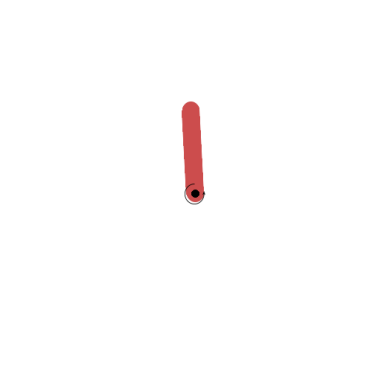

In [104]:
class DQNTestAgent:
    def __init__(self, weight_file_path):
        self.state_dim     = 3
        self.action_dim    = 9
        self.lr            = 0.01
        self.trained_model = weight_file_path
        self.Q = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q.load_state_dict(torch.load(self.trained_model))

    def choose_action(self, state):
        with torch.no_grad():
            action = float(torch.argmax(self.Q(state)).numpy())
            real_action = (action - 4) / 2
        return real_action


agent = DQNTestAgent('DQN/DQN138.pt')
test_agent(agent, 'Simple DQN')

**MODEL TRAINING EVOLUTION**
- Visualize how the model has improved over each episode

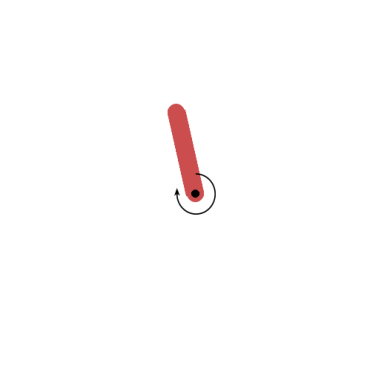

In [21]:
# Visualizing the pendulum's animation
create_animation(DQN_results['frames'])

### MODEL 3 : ENHANCED DQN MODEL 

- Now that we have experimented with a Simple DQN model, we can see that it already performs relatively well at balancing the pendulum upright.
- Hence, for the enhanced DQN model, we will be introducing improvements to the model to attempt at getting a better maximum score for the pendulum task in this model and **improve the average reward obtained** by the agent. Essentially, we want to reduce the penalty.

**We will mainly be exploring the following changes:**

- Adding one more layer to the neural network (Deepening the QNetwork Model).
- Increasing the `action_dim` from 9 to 15 (Increasing the number of discretized actions the pendulum can perform).
- Reducing the learning rate (by 0.009) and increasing the epsilon value (by 0.5).

In [52]:
# Defining the QNetwork class for the DQN Agent
class ImprovedQNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, q_lr):
        super(ImprovedQNetwork, self).__init__()

        self.fc_1 = nn.Linear(state_dim, 64)
        self.fc_2 = nn.Linear(64, 32)
        self.fc_3 = nn.Linear(32, 16) # Added another layer to the network
        self.fc_out = nn.Linear(16, action_dim)
        
        self.lr = q_lr
        self.optimizer = optim.Adam(self.parameters(), lr=self.lr)
        
    def forward(self, x):
        q = F.leaky_relu(self.fc_1(x))
        q = F.leaky_relu(self.fc_2(q))
        q = F.leaky_relu(self.fc_3(q)) 
        q = self.fc_out(q)
        return q

# Creating a class for the DQN Agent
class ImprovedDQNAgent:
    def __init__(self):
        self.state_dim     = 3
        self.action_dim    = 15 # Increased discretization of the action space
        self.lr            = 0.001 # Modified learning rate value by reducing it
        self.gamma         = 0.98
        self.tau           = 0.01
        self.epsilon       = 1.5 # Modified epsilon value by 0.5
        self.epsilon_decay = 0.98
        self.epsilon_min   = 0.001
        self.buffer_size   = 100000
        self.batch_size    = 200
        self.memory        = ReplayBuffer(self.buffer_size)
        self.Q        = ImprovedQNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target = ImprovedQNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target.load_state_dict(self.Q.state_dict())
        
    def choose_action(self, state):
        random_number = np.random.rand()
        maxQ_action_count = 0
        if self.epsilon < random_number:
            with torch.no_grad():
                action = float(torch.argmax(self.Q(state)).numpy())
                real_action = (action - 4) / 4
                maxQ_action_count = 1
        else:
            action = np.random.choice([n for n in range(9)])
            real_action = (action - 4) / 2
            
        return action, real_action, maxQ_action_count
    
    def calc_target(self, mini_batch):
        s, a, r, s_prime, done = mini_batch
        with torch.no_grad():
            q_target = self.Q_target(s_prime).max(1)[0].unsqueeze(1)
            target = r + self.gamma * done * q_target
        return target
    
    def train_agent(self):
        mini_batch = self.memory.sample(self.batch_size)
        s_batch, a_batch, r_batch, s_prime_batch, done_batch = mini_batch
        a_batch = a_batch.type(torch.int64)
        td_target = self.calc_target(mini_batch)

        # QNetwork training 
        Q_a = self.Q(s_batch).gather(1, a_batch)
        q_loss = F.smooth_l1_loss(Q_a, td_target)
        self.Q.optimizer.zero_grad()
        q_loss.mean().backward()
        self.Q.optimizer.step()

        # QNetwork Soft Update
        for param_target, param in zip(self.Q_target.parameters(), self.Q.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)

In [53]:
def train_ImprovedDQNAgent():
    # Initalize the DQN Agent and related variables required
    agent = ImprovedDQNAgent() 
    env = gym.make('Pendulum-v1', g=9.81)
    episodes = 800
    total_rewards = []
    frames = []
    no_of_steps = []
    success_count = 0
    best_episode = 0 
    best_reward = float('-inf')

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        maxQ_action_count = 0
        start_time = datetime.datetime.now()
        
        while not done:
            action, real_action, count = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([real_action])
            agent.memory.put((state, action, reward, state_prime, done))

            score += reward
            maxQ_action_count += count
            state = state_prime

            if maxQ_action_count % 100 == 0 and score > -50:
                screen = env.render(mode='rgb_array')
                frames.append(screen)

            if agent.memory.size() > 1000: 
                agent.train_agent()
                
        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200
        total_rewards.append(score)
        no_of_steps.append(maxQ_action_count)

        if score > best_reward:
            best_reward = score
            best_episode = episode
            
        # Saving the Models
        save_folder = "IMPROVED DQN"
        if not os.path.exists(save_folder):
            os.makedirs(save_folder)

        if episode == best_episode:
            model_name = os.path.join(save_folder, "IMPROVED_DQN" + str(episode) + ".pt")
            torch.save(agent.Q.state_dict(), model_name)
                
        if episode % 10 == 0:
            elapsed_time = datetime.datetime.now() - start_time
            print('Episode {:>4} | Total Reward: {:>8.2f} | MaxQ_Action_Count:{:>5} | Epsilon: {:>4.4f} | Elapsed: {}'.format(episode, score, maxQ_action_count, agent.epsilon, elapsed_time))   
            
        if agent.epsilon > agent.epsilon_min:
            agent.epsilon *= agent.epsilon_decay

    env.close()

    return {
        'total_rewards': total_rewards,
        'no_of_steps': no_of_steps,
        'success_count': success_count,
        'frames': frames
    }

ImprovedDQN_results = train_ImprovedDQNAgent()

Episode    0 | Total Reward: -1701.66 | MaxQ_Action_Count:    0 | Epsilon: 1.5000 | Elapsed: 0:00:00.465424
Episode   10 | Total Reward: -1765.65 | MaxQ_Action_Count:    0 | Epsilon: 1.2256 | Elapsed: 0:00:00.709585
Episode   20 | Total Reward: -1346.81 | MaxQ_Action_Count:    0 | Epsilon: 1.0014 | Elapsed: 0:00:00.650730
Episode   30 | Total Reward: -1693.30 | MaxQ_Action_Count:   31 | Epsilon: 0.8182 | Elapsed: 0:00:00.660949
Episode   40 | Total Reward:  -647.31 | MaxQ_Action_Count:   64 | Epsilon: 0.6686 | Elapsed: 0:00:00.625166
Episode   50 | Total Reward:  -760.08 | MaxQ_Action_Count:   79 | Epsilon: 0.5463 | Elapsed: 0:00:00.714982
Episode   60 | Total Reward:  -908.27 | MaxQ_Action_Count:  119 | Epsilon: 0.4463 | Elapsed: 0:00:00.623377
Episode   70 | Total Reward:  -253.43 | MaxQ_Action_Count:  136 | Epsilon: 0.3647 | Elapsed: 0:00:00.690183
Episode   80 | Total Reward:  -842.77 | MaxQ_Action_Count:  124 | Epsilon: 0.2980 | Elapsed: 0:00:00.662831
Episode   90 | Total Reward:

**VISUALIZING THE PERFORMANCE OF THE ENHANCED DQN MODEL**

- Our Enhanced DQN Model yielded significant improvements compared to the Simple DQN model. The average reward increased notably from -342.95 to -278.45, demonstrating a substantial performance boost. Additionally, the maximum reward achieved by this model improved significantly, reaching -0.30, which is much closer to the optimal reward of 0.
- These results affirm the effectiveness of the changes made in this model, particularly the increase in the number of discretized action spaces for the pendulum to explore.
- Consequently, the successful completion of the Pendulum task is evident through the high rewards obtained after training the model. Moving forward, we will explore a variation of the DQN algorithm - DDQN to assess its potential for achieving even better results in completing the task.

Performance Statistics for the Improved DQN Model:
--------------------------------------------
Best Episode   : 172
Average Reward : -265.13
Median Reward  : -130.56
Maximum Reward : -0.60
Minimum Reward : -1796.05


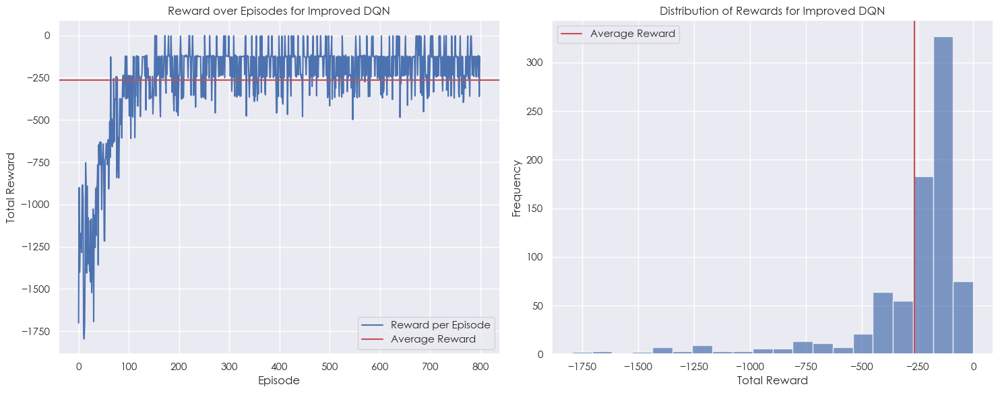

In [54]:
# Calculating statistical measures
average_reward = np.mean(ImprovedDQN_results['total_rewards'])
median_reward = np.median(ImprovedDQN_results['total_rewards'])
max_reward = np.max(ImprovedDQN_results['total_rewards'])
min_reward = np.min(ImprovedDQN_results['total_rewards'])

# Identifying the best episode
best_episode_index = np.argmax(ImprovedDQN_results['total_rewards']) 

# Printing the Statistics
print("Performance Statistics for the Improved DQN Model:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(ImprovedDQN_results['total_rewards'], average_reward, model_name="Improved DQN")

**VIEWING THE MODEL ARCHITECTURE AND PENDULUM ANIMATION**

- Now, we will be looking at the model architecture used to train the improved DQN agent using the `.eval()` function for PyTorch.
- We will also be viewing the animation of the pendulum's movement and visualize how the pendulum behaves.

In [55]:
# Load and view the model's architecture used for DQN
trained_model = ImprovedDQNAgent()
trained_model.Q.load_state_dict(torch.load("IMPROVED DQN/IMPROVED_DQN172.pt"))
trained_model.Q.eval()

ImprovedQNetwork(
  (fc_1): Linear(in_features=3, out_features=64, bias=True)
  (fc_2): Linear(in_features=64, out_features=32, bias=True)
  (fc_3): Linear(in_features=32, out_features=16, bias=True)
  (fc_out): Linear(in_features=16, out_features=15, bias=True)
)

**TESTING OUR MODEL WEIGHTS**
- There is no training involved
- It is to see if the saved model weights can keep the pendulum inverted

Test reward: -120.75985653386435


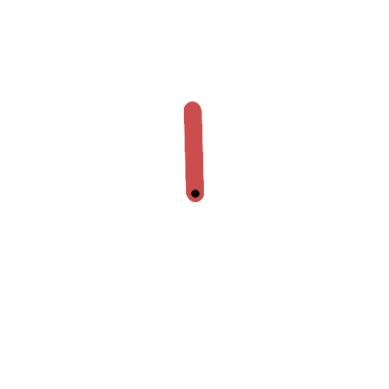

In [65]:
# Creating a class for the DQN Agent
class ImprovedDQNTestAgent:
    def __init__(self, weight_file_path):
        self.state_dim     = 3
        self.action_dim    = 15 # Increased discretization of the action space
        self.lr            = 0.001 # Modified learning rate value by reducing it
        self.trained_model = weight_file_path
        self.Q = ImprovedQNetwork(self.state_dim, self.action_dim, self.lr)        
        self.Q.load_state_dict(torch.load(self.trained_model))
        
    def choose_action(self, state):
        with torch.no_grad():
            action = float(torch.argmax(self.Q(state)).numpy())
            real_action = (action - 4) / 2
        return real_action
    
agent = ImprovedDQNTestAgent('IMPROVED DQN/IMPROVED_DQN172.pt')
test_agent(agent, 'Improved DQN')

**MODEL TRAINING EVOLUTION**
- Visualize how the model has improved over each episode

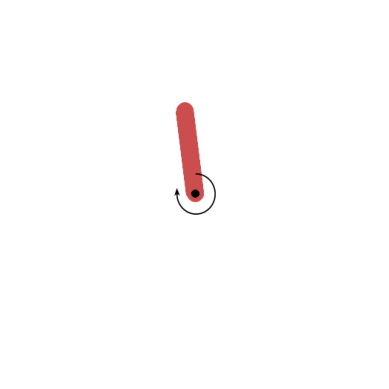

In [22]:
# Visualizing the pendulum's animation
create_animation(ImprovedDQN_results['frames'])

### MODEL 4 : DOUBLE DEEP-Q NETWORK (DDQN)

The Double Deep-Q Network (DDQN) is an advanced reinforcement learning model that builds upon the architecture of the Deep-Q Network (DQN). **It addresses a critical shortcoming in the DQN, namely the overestimation of action values due to the same network being used for both selecting and evaluating an action.**

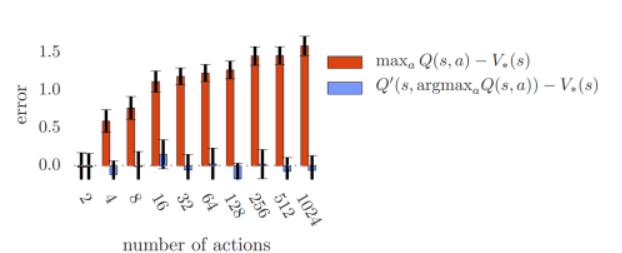

- **Two Neural Networks**: DDQN utilizes two distinct neural networks with identical architectures. The first network, called the evaluation network, is used for selecting the best action given the current state. The second network, known as the target network, is used for evaluating the action's value.
- **Delayed Target Network Updates**: The target network's weights are periodically updated with the weights of the evaluation network. This delayed update, as opposed to updating after every learning step as in DQN, helps in stabilizing the learning process.
- **Action Selection and Evaluation Separation**: In DDQN, the action is chosen using the evaluation network, but its value is estimated using the target network. This separation reduces the risk of overoptimistic value estimates, a problem common in the standard DQN.

**WHAT ARE THE ADVANTAGES OF DDQN?**

The Double Deep-Q Network (DDQN) offers significant advantages over the traditional Deep-Q Network (DQN) in terms of learning accuracy and stability. By separating action selection and value estimation between two neural networks, DDQN effectively reduces the overestimation bias common in DQNs. This separation ensures more reliable and stable learning outcomes. Additionally, the strategy of using delayed updates for the target network contributes to the overall stability of the learning process. Furthermore, DDQN typically exhibits enhanced performance, especially in environments characterized by noisy or misleading reward signals, demonstrating its superiority in complex learning scenarios.

**SETTING UP THE MODEL ARCHITECTURE FOR THE DDQN MODEL**

- The parameters used in the DDQN architecture will follow the improved DQN model's parameters, as it was shown to return better rewards. Hence, DDQN is used in the hopes that it can further improve the reward obtained more with stabilization of the Q-values.

**Below contains the sections changed to suit DDQN's architecture:**

- **Action Selection Process** : Actions during the agent's decision-making process in the `choose_action` function are selected using the target network `self.Q_target`.
- **Target Q-Value Calculation** : DDQN uses the main network to select the action but uses the target values instead to estimate the value of that action, which is the opposite of the DQN architecture.

In [95]:
# Defining the QNetwork class for the DDQN Agent
class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, q_lr):
        super(QNetwork, self).__init__()

        self.fc_1 = nn.Linear(state_dim, 64)
        self.fc_2 = nn.Linear(64, 32)
        self.fc_3 = nn.Linear(32, 16) 
        self.fc_out = nn.Linear(16, action_dim)
        
        self.lr = q_lr
        self.optimizer = optim.Adam(self.parameters(), lr=self.lr)
        
    def forward(self, x):
        q = F.leaky_relu(self.fc_1(x))
        q = F.leaky_relu(self.fc_2(q))
        q = F.leaky_relu(self.fc_3(q)) 
        q = self.fc_out(q)
        return q

# Creating a class for the DDQN Agent
class DDQNAgent:
    def __init__(self):
        self.state_dim     = 3
        self.action_dim    = 15 
        self.lr            = 0.001 
        self.gamma         = 0.98
        self.tau           = 0.01
        self.epsilon       = 1.5 
        self.epsilon_decay = 0.98
        self.epsilon_min   = 0.001
        self.buffer_size   = 100000
        self.batch_size    = 200
        self.memory        = ReplayBuffer(self.buffer_size)
        self.Q        = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q_target.load_state_dict(self.Q.state_dict())
        
    def choose_action(self, state):
        random_number = np.random.rand()
        maxQ_action_count = 0
        if self.epsilon < random_number:
            with torch.no_grad():
                # Use Q_target for action selection
                action = float(torch.argmax(self.Q_target(state)).numpy())
                real_action = (action - 4) / 4
                maxQ_action_count = 1
        else:
            action = np.random.choice([n for n in range(9)])
            real_action = (action - 4) / 2
            
        return action, real_action, maxQ_action_count
    
    def calc_target(self, mini_batch):
        s, a, r, s_prime, done = mini_batch
        with torch.no_grad():
            # Use Q for action selection
            best_next_action = torch.argmax(self.Q(s_prime), dim=1, keepdim=True)
            q_target = self.Q_target(s_prime).gather(1, best_next_action)
            target = r + self.gamma * done * q_target
        return target
    
    def train_agent(self):
        mini_batch = self.memory.sample(self.batch_size)
        s_batch, a_batch, r_batch, s_prime_batch, done_batch = mini_batch
        a_batch = a_batch.type(torch.int64)
        td_target = self.calc_target(mini_batch)

        # QNetwork training 
        Q_a = self.Q(s_batch).gather(1, a_batch)
        q_loss = F.smooth_l1_loss(Q_a, td_target)
        self.Q.optimizer.zero_grad()
        q_loss.mean().backward()
        self.Q.optimizer.step()

        # QNetwork Soft Update for DDQN
        for param_target, param in zip(self.Q_target.parameters(), self.Q.parameters()):
            param_target.data.copy_(self.tau * param.data + (1.0 - self.tau) * param_target.data)

In [83]:
def train_DDQNAgent():
    # Initalize the DQN Agent and related variables required
    agent = DDQNAgent() 
    env = gym.make('Pendulum-v1', g=9.81)
    episodes = 800
    total_rewards = []
    success_count = 0
    no_of_steps = []
    frames = []
    best_episode = 0 
    best_reward = float('-inf')

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        maxQ_action_count = 0
        start_time = datetime.datetime.now()
        
        while not done:
            action, real_action, count = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([real_action])
            agent.memory.put((state, action, reward, state_prime, done))

            score += reward
            maxQ_action_count += count
            state = state_prime

            if maxQ_action_count % 100 == 0 and score > -50:
                screen = env.render(mode='rgb_array')
                frames.append(screen)

            if agent.memory.size() > 1000: 
                agent.train_agent()
        
        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200
        total_rewards.append(score)
        no_of_steps.append(maxQ_action_count)

        if score > best_reward:
            best_reward = score
            best_episode = episode
            
        # Saving the Models
        save_folder = "DDQN"
        if not os.path.exists(save_folder):
            os.makedirs(save_folder)

        if episode == best_episode:
            model_name = os.path.join(save_folder, "DDQN" + str(episode) + ".pt")
            torch.save(agent.Q.state_dict(), model_name)
                
        if episode % 10 == 0:
            elapsed_time = datetime.datetime.now() - start_time
            print('Episode {:>4} | Total Reward: {:>8.2f} | MaxQ_Action_Count:{:>5} | Epsilon: {:>4.4f} | Elapsed: {}'.format(episode, score, maxQ_action_count, agent.epsilon, elapsed_time))   
            
        if agent.epsilon > agent.epsilon_min:
            agent.epsilon *= agent.epsilon_decay

    env.close()

    return {
        'total_rewards': total_rewards,
        'no_of_steps': no_of_steps,
        'success_count': success_count,
        'frames': frames
    }

DDQN_results = train_DDQNAgent()

Episode    0 | Total Reward: -1080.22 | MaxQ_Action_Count:    0 | Epsilon: 1.5000 | Elapsed: 0:00:00.492155
Episode   10 | Total Reward:  -784.74 | MaxQ_Action_Count:    0 | Epsilon: 1.2256 | Elapsed: 0:00:00.857798
Episode   20 | Total Reward: -1393.62 | MaxQ_Action_Count:    0 | Epsilon: 1.0014 | Elapsed: 0:00:00.723278
Episode   30 | Total Reward:  -972.29 | MaxQ_Action_Count:   32 | Epsilon: 0.8182 | Elapsed: 0:00:00.691218
Episode   40 | Total Reward: -1041.89 | MaxQ_Action_Count:   64 | Epsilon: 0.6686 | Elapsed: 0:00:00.558482
Episode   50 | Total Reward:  -628.97 | MaxQ_Action_Count:   80 | Epsilon: 0.5463 | Elapsed: 0:00:00.693278
Episode   60 | Total Reward:  -508.24 | MaxQ_Action_Count:  114 | Epsilon: 0.4463 | Elapsed: 0:00:00.717819
Episode   70 | Total Reward:  -243.42 | MaxQ_Action_Count:  133 | Epsilon: 0.3647 | Elapsed: 0:00:00.712669
Episode   80 | Total Reward:  -122.18 | MaxQ_Action_Count:  144 | Epsilon: 0.2980 | Elapsed: 0:00:00.772529
Episode   90 | Total Reward:

**VISUALIZING THE PERFORMANCE OF THE DOUBLE DQN MODEL**

- From our Double-DQN model, we can see that its performance in comparison to the Improved DQN Model is actually roughly the same, with the exception that it was able to achieve a slightly better average reward value of -276.94 compared to the Improved DQN Model with -278.45.
- The slightly improved perfromance of the Double-DQN model could possibly be attributed to its ability to address overestimation bias present in traditional DQN algorithms.
- One reason for the similar performance could be due to the Pendulum environment being relatively simple, with simple state and action spaces, hence the benefits of advanced techniques like Double-DQN may not be as pronounced as in more complex tasks

Performance Statistics for the Double DQN Model:
--------------------------------------------
Best Episode   : 776
Average Reward : -261.91
Median Reward  : -129.09
Maximum Reward : -0.26
Minimum Reward : -1756.07


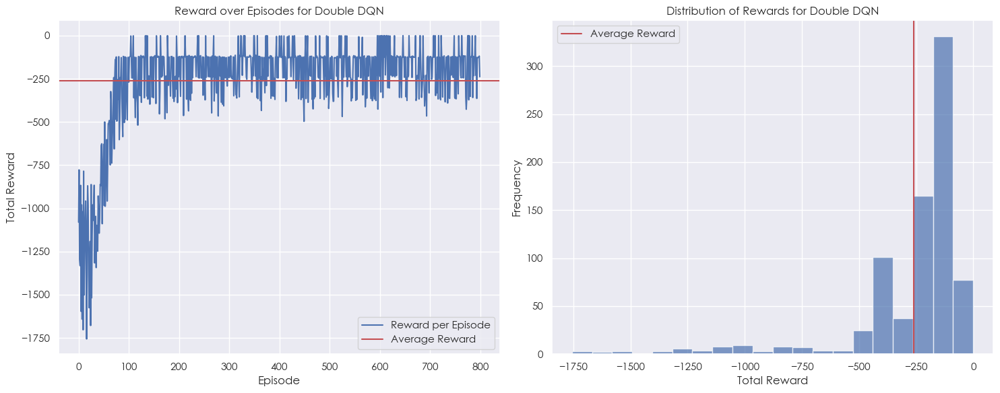

In [84]:
# Calculating statistical measures
average_reward = np.mean(DDQN_results['total_rewards'])
median_reward = np.median(DDQN_results['total_rewards'])
max_reward = np.max(DDQN_results['total_rewards'])
min_reward = np.min(DDQN_results['total_rewards'])

# Identifying the best episode
best_episode_index = np.argmax(DDQN_results['total_rewards']) 

# Printing the Statistics
print("Performance Statistics for the Double DQN Model:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(DDQN_results['total_rewards'], average_reward, model_name="Double DQN")

**VIEWING THE MODEL ARCHITECTURE AND PENDULUM ANIMATION**

- Now, we will be looking at the model architecture used to train the Double DQN agent using the `.eval()` function for PyTorch.
- We will also be viewing the animation of the pendulum's movement and visualize how the pendulum behaves.

In [96]:
# Load and view the model's architecture used for DDQN
trained_model = DDQNAgent()
trained_model.Q.load_state_dict(torch.load("DDQN/DDQN776.pt"))
trained_model.Q.eval()

QNetwork(
  (fc_1): Linear(in_features=3, out_features=64, bias=True)
  (fc_2): Linear(in_features=64, out_features=32, bias=True)
  (fc_3): Linear(in_features=32, out_features=16, bias=True)
  (fc_out): Linear(in_features=16, out_features=15, bias=True)
)

**TESTING OUR MODEL WEIGHTS**
- There is no training involved
- It is to see if the saved model weights can keep the pendulum inverted

Test reward: -367.44327135316513


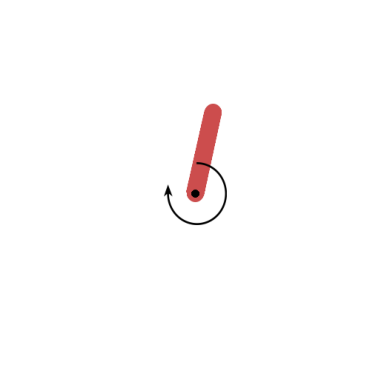

In [97]:
class DDQNTestAgent:
    def __init__(self, weight_file_path):
        self.state_dim     = 3
        self.action_dim    = 15 
        self.lr            = 0.001
        self.trained_model = weight_file_path
        self.Q        = QNetwork(self.state_dim, self.action_dim, self.lr)
        self.Q.load_state_dict(torch.load(self.trained_model))
        
    def choose_action(self, state):
        with torch.no_grad():
            action = float(torch.argmax(self.Q(state)).numpy())
            real_action = (action - 4) / 2
        return real_action
            
agent = DDQNTestAgent("DDQN/DDQN776.pt")
test_agent(agent, 'DDQN')

**MODEL TRAINING EVOLUTION**
- Visualize how the model has improved over each episode

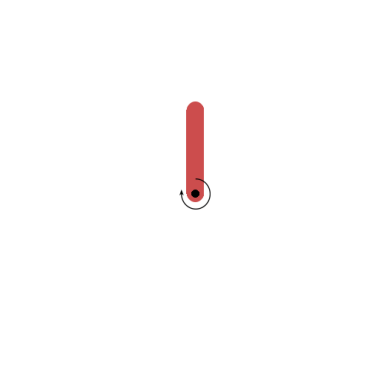

In [62]:
# Visualizing the pendulum's animation
create_animation(DDQN_results['frames'])

### MODEL 5 : SOFT ACTOR-CRITIC NETWORK (SAC)

The Soft Actor-Critic Network is an agent that employs a stochastic policy for action selection, enabling it to capture the inherent uncertainty in many real-world environments. This stochasticity helps SAC to explore better and handle environments with continuous action spaces, which is suitable in the case of the Pendulum task.

For SAC, it introduces an entropy term into the objective function. This term encourages the policy to take actions that are not only rewarding but also diverse. It prevents premature convergence to suboptimal policies and aids in exploration. At the same time, SAC uses a soft value function, allowing it to handle both continuous and discrete action spaces seamlessly.

**WHAT ARE THE ADVANTAGES OF SAC?**

- **Stochastic Policies**: SAC's use of stochastic policies allows for better exploration, especially in environments with continuous action spaces, where deterministic policies may struggle.

- **Entropy Regularization**: The inclusion of an entropy regularization term encourages diverse actions and robust exploration, preventing the algorithm from getting stuck in suboptimal solutions.

- **Sample Efficiency**: Being an off-policy algorithm, SAC can make more efficient use of past experiences, reducing the need for extensive interaction with the environment.

- **Versatility**: SAC can handle both continuous and discrete action spaces, making it suitable for a wide range of reinforcement learning tasks.

- **Actor-Critic Separation**: Separating the actor and critic networks reduces overestimation bias and contributes to more stable learning.

**SETTING UP THE MODEL ARCHITECTURE FOR THE SAC MODEL**

In [87]:
# Defining the PolicyNetwork class for the SAC Agent
class PolicyNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, actor_lr):
        super(PolicyNetwork, self).__init__()

        self.fc_1 = nn.Linear(state_dim, 64)
        self.fc_2 = nn.Linear(64, 64)
        self.fc_mu = nn.Linear(64, action_dim)
        self.fc_std = nn.Linear(64, action_dim)

        self.lr = actor_lr

        self.LOG_STD_MIN = -20
        self.LOG_STD_MAX = 2
        self.max_action = 2
        self.min_action = -2
        self.action_scale = (self.max_action - self.min_action) / 2.0
        self.action_bias = (self.max_action + self.min_action) / 2.0

        self.optimizer = optim.Adam(self.parameters(), lr=self.lr)

    def forward(self, x):
        x = F.leaky_relu(self.fc_1(x))
        x = F.leaky_relu(self.fc_2(x))
        mu = self.fc_mu(x)
        log_std = self.fc_std(x)
        log_std = torch.clamp(log_std, self.LOG_STD_MIN, self.LOG_STD_MAX)
        return mu, log_std

    def sample(self, state):
        mean, log_std = self.forward(state)
        std = torch.exp(log_std)
        reparameter = Normal(mean, std)
        x_t = reparameter.rsample()
        y_t = torch.tanh(x_t)
        action = self.action_scale * y_t + self.action_bias

        # # Enforcing Action Bound
        log_prob = reparameter.log_prob(x_t)
        log_prob = log_prob - torch.sum(torch.log(self.action_scale * (1 - y_t.pow(2)) + 1e-6), dim=-1, keepdim=True)

        return action, log_prob
       
# Defining the QNetwork class for the SAC Agent    
class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, critic_lr):
        super(QNetwork, self).__init__()

        self.fc_s = nn.Linear(state_dim, 32)
        self.fc_a = nn.Linear(action_dim, 32)
        self.fc_1 = nn.Linear(64, 64)
        self.fc_out = nn.Linear(64, action_dim)

        self.lr = critic_lr

        self.optimizer = optim.Adam(self.parameters(), lr=self.lr)

    def forward(self, x, a):
        h1 = F.leaky_relu(self.fc_s(x))
        h2 = F.leaky_relu(self.fc_a(a))
        cat = torch.cat([h1, h2], dim=-1)
        q = F.leaky_relu(self.fc_1(cat))
        q = self.fc_out(q)
        return q
    
# Creating and defining the SAC Agent
class SACAgent:
    def __init__(self):
        self.state_dim      = 3  
        self.action_dim     = 1 
        self.lr_pi          = 0.001
        self.lr_q           = 0.001
        self.gamma          = 0.98
        self.batch_size     = 200
        self.buffer_limit   = 100000
        self.tau            = 0.005  
        self.init_alpha     = 0.01
        self.target_entropy = -self.action_dim 
        self.lr_alpha       = 0.005
        self.memory         = ReplayBuffer(self.buffer_limit)
        self.log_alpha = torch.tensor(np.log(self.init_alpha))
        self.log_alpha.requires_grad = True
        self.log_alpha_optimizer = optim.Adam([self.log_alpha], lr=self.lr_alpha)

        self.PI  = PolicyNetwork(self.state_dim, self.action_dim, self.lr_pi)
        self.Q1        = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q1_target = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q2        = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q2_target = QNetwork(self.state_dim, self.action_dim, self.lr_q)

        self.Q1_target.load_state_dict(self.Q1.state_dict())
        self.Q2_target.load_state_dict(self.Q2.state_dict())

    def choose_action(self, s):
        with torch.no_grad():
            action, log_prob = self.PI.sample(s)
        return action, log_prob

    def calc_target(self, mini_batch):
        s, a, r, s_prime, done = mini_batch
        with torch.no_grad():
            a_prime, log_prob_prime = self.PI.sample(s_prime)
            entropy = - self.log_alpha.exp() * log_prob_prime
            q1_target, q2_target = self.Q1_target(s_prime, a_prime), self.Q2_target(s_prime, a_prime)
            q_target = torch.min(q1_target, q2_target)
            target = r + self.gamma * done * (q_target + entropy)
        return target

    def train_agent(self):
        mini_batch = self.memory.sample(self.batch_size)
        s_batch, a_batch, r_batch, s_prime_batch, done_batch = mini_batch
        td_target = self.calc_target(mini_batch)

        # Training of Q1
        q1_loss = F.smooth_l1_loss(self.Q1(s_batch, a_batch), td_target)
        self.Q1.optimizer.zero_grad()
        q1_loss.mean().backward()
        self.Q1.optimizer.step()

        # Training of Q2
        q2_loss = F.smooth_l1_loss(self.Q2(s_batch, a_batch), td_target)
        self.Q2.optimizer.zero_grad()
        q2_loss.mean().backward()
        self.Q2.optimizer.step()

        # Training of PI
        a, log_prob = self.PI.sample(s_batch)
        entropy = -self.log_alpha.exp() * log_prob
        q1, q2 = self.Q1(s_batch, a), self.Q2(s_batch, a)
        q = torch.min(q1, q2)
        pi_loss = -(q + entropy) # For gradient ascent
        self.PI.optimizer.zero_grad()
        pi_loss.mean().backward()
        self.PI.optimizer.step()

        # Alpha train
        self.log_alpha_optimizer.zero_grad()
        alpha_loss = -(self.log_alpha.exp() * (log_prob + self.target_entropy).detach()).mean()
        alpha_loss.backward()
        self.log_alpha_optimizer.step()

        # Soft update of Q1 and Q2
        for param_target, param in zip(self.Q1_target.parameters(), self.Q1.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)
        
        for param_target, param in zip(self.Q2_target.parameters(), self.Q2.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)

In [88]:
def train_SACAgent():
    # Initalize the SAC Agent and related variables required
    agent = SACAgent() 
    env = gym.make('Pendulum-v1', g=9.81)
    episodes = 800
    total_rewards = []
    no_of_steps = []
    success_count = 0
    frames = []
    best_episode = 0 
    best_reward = float('-inf')

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        start_time = datetime.datetime.now()
        counter = 0
        
        while not done:
            counter += 1
            action, log_prob = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([action])
            agent.memory.put((state, action, reward, state_prime, done))

            score += reward
            state = state_prime

            if counter % 50 == 0 and score > -50:
                screen = env.render(mode='rgb_array')
                frames.append(screen)

            if agent.memory.size() > 1000: 
                agent.train_agent()

        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200
        total_rewards.append(score)
        no_of_steps.append(counter)
        
        if score > best_reward:
            best_reward = score
            best_episode = episode
            
        # Saving the Models
        save_folder = "SAC"
        if not os.path.exists(save_folder):
            os.makedirs(save_folder)

        if episode == best_episode:
            model_name = os.path.join(save_folder, "SAC" + str(episode) + ".pt")
            torch.save(agent.PI.state_dict(), model_name)
            
        if episode % 10 == 0:
            elapsed_time = datetime.datetime.now() - start_time
            print('Episode {:>4} | Total Reward: {:>8.2f} | Elapsed: {}'.format(episode, score, elapsed_time))   
    
    env.close()

    return {
        'total_rewards': total_rewards,
        'no_of_steps': no_of_steps,
        'success_count': success_count,
        'frames': frames
    }

SAC_results = train_SACAgent()

Episode    0 | Total Reward: -1263.81 | Elapsed: 0:00:00.091711
Episode   10 | Total Reward: -1489.46 | Elapsed: 0:00:02.265242
Episode   20 | Total Reward:  -389.96 | Elapsed: 0:00:02.632590
Episode   30 | Total Reward:  -127.36 | Elapsed: 0:00:02.051764
Episode   40 | Total Reward:  -131.92 | Elapsed: 0:00:02.080935
Episode   50 | Total Reward:  -368.68 | Elapsed: 0:00:01.994790
Episode   60 | Total Reward:  -125.87 | Elapsed: 0:00:02.099870
Episode   70 | Total Reward:  -495.16 | Elapsed: 0:00:02.093062
Episode   80 | Total Reward:    -3.40 | Elapsed: 0:00:02.169272
Episode   90 | Total Reward:    -0.80 | Elapsed: 0:00:02.194396
Episode  100 | Total Reward:  -373.32 | Elapsed: 0:00:02.114902
Episode  110 | Total Reward:  -115.08 | Elapsed: 0:00:02.178001
Episode  120 | Total Reward:  -126.53 | Elapsed: 0:00:02.228045
Episode  130 | Total Reward:  -252.04 | Elapsed: 0:00:02.115674
Episode  140 | Total Reward:  -248.56 | Elapsed: 0:00:02.073931
Episode  150 | Total Reward:  -130.85 | 

**VISUALIZING THE PERFORMANCE FOR THE SOFT ACTOR-CRITIC MODEL**

- Based on the results of the Soft Actor-Critic Model, we find that it actually performed better than the DQN models tested earlier. Although the DQN models were successful in balancing the pendulum, this SAC agent managed to achieve a much better average reward of -128.11.
- This shows that the Soft Actor-Critic model has its advantages in the Pendulum environment, possibly due to it being designed to handle continuous actions, while DQN typically deals with discrete action spaces and requires discretization of the action space for continuous action tasks.
- Another reason could also be that SAC employs  a stochastic policy, which allows for efficient exploration in continuous action spaces.

Performance Statistics for the SAC Model:
--------------------------------------------
Best Episode   : 42
Average Reward : -188.68
Median Reward  : -131.26
Maximum Reward : -0.14
Minimum Reward : -1850.31


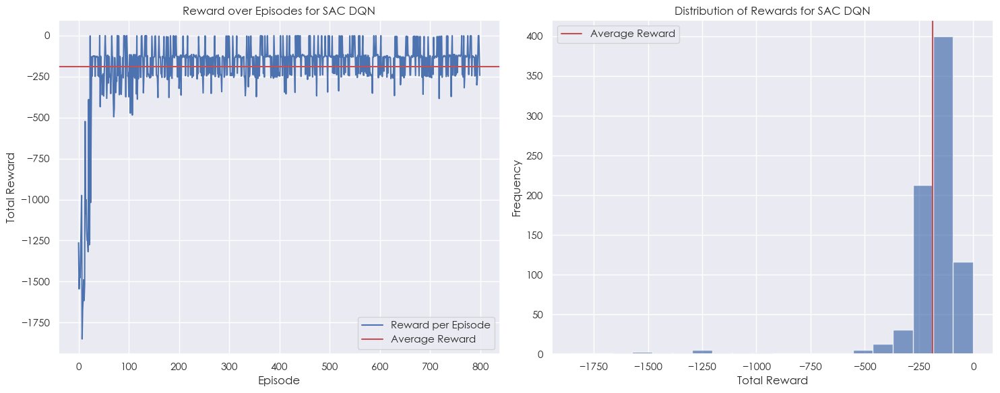

In [89]:
# Calculating statistical measures
average_reward = np.mean(SAC_results['total_rewards'])
median_reward = np.median(SAC_results['total_rewards'])
max_reward = np.max(SAC_results['total_rewards'])
min_reward = np.min(SAC_results['total_rewards'])

# Identifying the best episode
best_episode_index = np.argmax(SAC_results['total_rewards']) 

# Printing the Statistics
print("Performance Statistics for the SAC Model:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(SAC_results['total_rewards'], average_reward, model_name="SAC DQN")

**VIEWING THE MODEL ARCHITECTURE AND PENDULUM ANIMATION**

- Now, we will be looking at the model architecture used to train the SAC agent using the `.eval()` function for PyTorch.
- We will also be viewing the animation of the pendulum's movement and visualize how the pendulum behaves.

In [92]:
# Load and view the model's architecture used for SAC
trained_model = SACAgent()
trained_model.PI.load_state_dict(torch.load("SAC/SAC42.pt"))
trained_model.PI.eval()

PolicyNetwork(
  (fc_1): Linear(in_features=3, out_features=64, bias=True)
  (fc_2): Linear(in_features=64, out_features=64, bias=True)
  (fc_mu): Linear(in_features=64, out_features=1, bias=True)
  (fc_std): Linear(in_features=64, out_features=1, bias=True)
)

**TESTING OUR MODEL WEIGHTS**
- There is no training involved
- It is to see if the saved model weights can keep the pendulum inverted

>Note there is no need to create a new model because the choose_action function of SAC does not make use of randomly generated numbers to encourage exploration

Test reward: -127.53441782760822


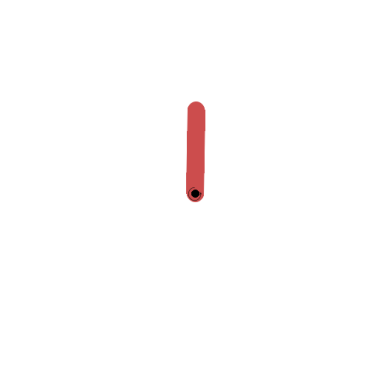

In [93]:
test_agent(trained_model, 'SAC')

**MODEL TRAINING EVOLUTION**
- Visualize how the model has improved over each episode

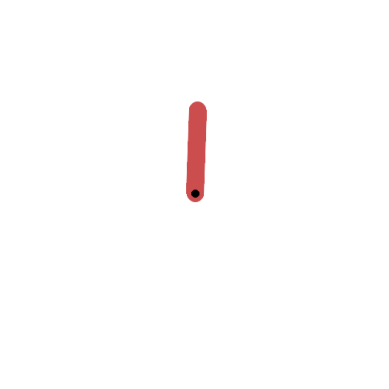

In [74]:
# Visualizing the pendulum's animation
create_animation(SAC_results['frames']) # Visualizing the pendulum's animation

### MODEL EVALUATION AND PERFORMANCE ANALYSIS

In this section, we will be performing an evaluation with **800 testing episodes** for each model. For performance analysis and evaluation, we will be doing the following:

- Showing the evaluation statistics for each model
- Visualize Average Reward and Success Rate for each model
- Perform two sample independent t-test to determine statistical significance
- Evaluate the Model's Efficiency

**PERFORMING CALCULATIONS**

In this section, we will first perform the calculations necessary to evaluate the performance of each model. The following steps are carried out:

- Collect data from each model by running 800 testing episodes.
- Calculate the metrics (avg reward, std reward, avg steps, std steps, success rate) for each model.

In [9]:
class MetricsCalculator:
    def __init__(self, total_rewards, no_of_steps, success_count, n_episodes, frames):
        self.total_rewards = total_rewards
        self.no_of_steps = no_of_steps
        self.success_count = success_count
        self.n_episodes = n_episodes
        self.frames = frames

    def avg_reward_per_episode(self):
        sum_reward = np.sum(self.total_rewards)
        return sum_reward / self.n_episodes

    def std_reward_per_episode(self):
        return np.std(self.total_rewards)

    def avg_steps_taken(self):
        step_count = np.sum(self.no_of_steps)
        return step_count / self.n_episodes

    def std_steps_taken(self):
        return np.std(self.no_of_steps)

    def avg_reward_per_step(self):
        sum_reward = np.sum(self.total_rewards)
        step_count = np.sum(self.no_of_steps)
        return sum_reward / step_count

    def success_rate(self):
        return self.success_count / self.n_episodes

    def render_frames(self):
        create_animation(self.frames)
        pass

In [76]:
DQN_metrics = MetricsCalculator(**DQN_results, n_episodes=800)
ImprovedDQN_metrics = MetricsCalculator(**ImprovedDQN_results, n_episodes=800)
DDQN_metrics = MetricsCalculator(**DDQN_results, n_episodes=800)
SAC_metrics = MetricsCalculator(**SAC_results, n_episodes=800)

In [77]:
def create_dataframe_from_dict(data_dict, column_name=None):
    df = pd.DataFrame.from_dict(data_dict, orient='index')
    if column_name:
        df.columns = [column_name]
    return df

**PLOTTING THE REWARD BAR PLOT**

- Here, we visualize the performance of various reinforcement learning models on the Pendulum task. The bar plot displays the average reward obtained by each model over the evaluation episodes. 
- This helps when we are comparing the effectiveness of different algorithms and choose the best one for our application. They highlight perhaps the trade-off between stability and exploration in reinforcement learning and allow us to gain insights into the behavior of these models.

In [78]:
# Your dictionary
all_avg_reward_per_episode = {
    'DQN': DQN_metrics.avg_reward_per_episode(),
    'Improved DQN': ImprovedDQN_metrics.avg_reward_per_episode(),
    'DDQN': DDQN_metrics.avg_reward_per_episode(),
    'SAC': SAC_metrics.avg_reward_per_episode()
}

# Convert the dictionary to a DataFrame
df = create_dataframe_from_dict(all_avg_reward_per_episode, 'Avg_Reward_Per_Episode')
df

,Avg_Reward_Per_Episode
DQN,-340.944229
Improved DQN,-545.086096
DDQN,-569.351038
SAC,-176.178789


SAC had the largest average reward per episode, indicating its impressive ability to consistently achieve high rewards. Surprisingly, DQN performed better in this evaluation than the Improved/Enhanced DQN.

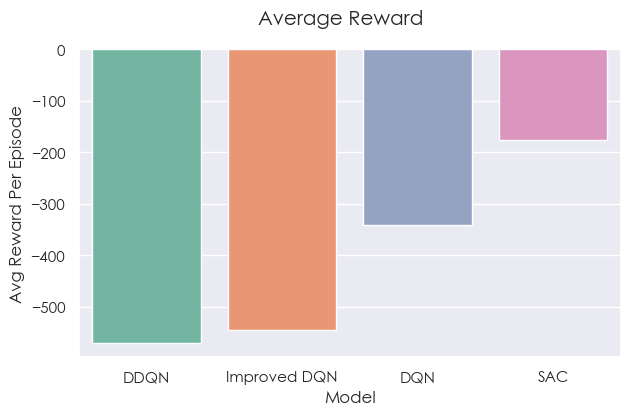

In [79]:
# Sort the DataFrame by 'Avg_Reward_Per_Episode' in ascending order
df = df.sort_values(by='Avg_Reward_Per_Episode', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Average Reward")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='Avg_Reward_Per_Episode',
    x=df.index,  # Swap x and y axes
    ax=ax,
    palette=sns.color_palette('Set2')
)

# ax.legend()
ax.set_ylabel('Avg Reward Per Episode')  # Swap x and y axis labels
ax.set_xlabel('Model')  # Swap x and y axis labels

plt.show()

**PLOTTING THE SUCCESS RATE OF THE MODELS**

- Now, we will take a look at the success rates of the models to find out which model has the highest rate of succeeding at the Pendulum task.

In [80]:
# Your dictionary
all_success_rate = {
    'DQN': DQN_metrics.success_rate(),
    'Improved DQN': ImprovedDQN_metrics.success_rate(),
    'DDQN': DDQN_metrics.success_rate(),
    'SAC': SAC_metrics.success_rate()
}

# Convert the dictionary to a DataFrame
df = create_dataframe_from_dict(all_success_rate, 'success_rate')
df

,success_rate
DQN,0.2450
Improved DQN,0.1525
DDQN,0.1575
SAC,0.0725


Success rate means "How often does a model improve on its previous results". 

DQN had the higheset success rate because its training was quite irregular. However, whenever it performed badly, it was able to correct itself quickly in the next episode. It displays its inability to adapt to changing environments as it tries the same policy on a continuous environment which causes it to fail for that particular episode, but is able to learn from that and improve the very next episode. 

SAC was the lowest in this evaluation because it achieve success and stability of attaining high rewards very early on which provided it with less opportunities to "bounce back" from unfavourable episodes.

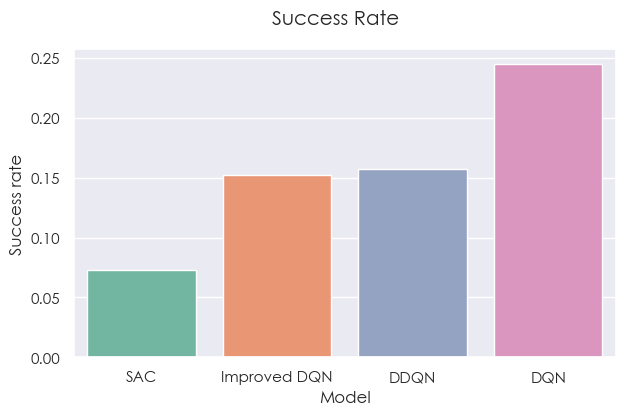

In [81]:
# Sort the DataFrame by 'success_rate' in ascending order
df = df.sort_values(by='success_rate', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Success Rate")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='success_rate',
    x=df.index,  # Swap x and y axes
    ax=ax,
    palette=sns.color_palette('Set2')
)

ax.set_ylabel('Success rate') 
ax.set_xlabel('Model') 

plt.show()

**TWO SAMPLE INDEPENDENT T-TEST**

- Next, we perform a two sample independent t-test between the top two models to determine if there is any statistical significance. This is because although the mean of one model may be higher than another model, if the standard deviations are large enough, in fact the significance of that difference in mean may just be due to randomness. 
- Likewise, it may be possible that the means between two models appear very similar to each other, however they may actually be significantly different if the standard deviations are small. Although the large number of episodes may reduce the visual difference effect has on our analysis, it is much better to perform a statistical test.

- **Null Hypothesis(H0)**: Average results from the different models are identical
- **Alternate Hypothesis(H1)**: Average results from the different models are not identical

With a 95% confidence level, from the test results, all models but one are different from each other (H0 is rejected). This is shown by the very small p-value, except for `Improved DQN` and `DDQN` which had a p-value of 0.09 (> 0.05), therefore H0 cannot be rejected.

In [82]:
import numpy as np
from scipy import stats

def two_sample_t_test(mean1, std1, mean2, std2, n1, n2):
    t, p = stats.ttest_ind_from_stats(mean1, std1, n1, mean2, std2, n2)
    return p

# Define the model metrics
dqn_avg = DQN_metrics.avg_reward_per_episode()
dqn_std = DQN_metrics.std_reward_per_episode()

improved_dqn_avg = ImprovedDQN_metrics.avg_reward_per_episode()
improved_dqn_std = ImprovedDQN_metrics.std_reward_per_episode()

ddqn_avg = DDQN_metrics.avg_reward_per_episode()
ddqn_std = DDQN_metrics.std_reward_per_episode()

sac_avg = SAC_metrics.avg_reward_per_episode()
sac_std = SAC_metrics.std_reward_per_episode()

# Sample sizes
n1 = 800
n2 = 800

# Perform two-sample t-tests and print the results
models = ["DQN", "Improved_DQN", "DDQN", "SAC"]

for i in range(len(models)):
    for j in range(i+1, len(models)):
        model1 = models[i]
        model2 = models[j]

        p_value = two_sample_t_test(
            eval(f"{model1.lower()}_avg"),
            eval(f"{model1.lower()}_std"),
            eval(f"{model2.lower()}_avg"),
            eval(f"{model2.lower()}_std"),
            n1, n2
        )

        print(f"Two-sample t-test between {model1} and {model2}: p-value = {p_value}")

Two-sample t-test between DQN and Improved_DQN: p-value = 1.8851302977853567e-45
Two-sample t-test between DQN and DDQN: p-value = 4.460181319774324e-55
Two-sample t-test between DQN and SAC: p-value = 1.4132384619600633e-40
Two-sample t-test between Improved_DQN and DDQN: p-value = 0.09470622155215883
Two-sample t-test between Improved_DQN and SAC: p-value = 2.3701112197964183e-152
Two-sample t-test between DDQN and SAC: p-value = 1.0529611551567295e-166


**ANALYSIS OF MODEL EFFICIENCY**

Now, we will be analyzing the **efficiency** of our models. We define efficiency as **the ability to achieve more with less**, which in our case would be asking "How good is a model at gaining rewards without the extensive use of steps?". We can assess this with two metrics:

- **Step Count**. This metric is self explanatory, we track the number of steps each model takes. The higher score indicates which models on average take longer to finish, while vice versa for the lower.

- **Efficiency Score**. We calculate this metric by performing:

$$\sum_{i=1}^{k}\frac{\text{reward}(i;\pi)}{\text{step}(i;\pi)}$$

$$\text{where }i\text{ represents the i'th testing episode, }\pi\text{ represents the policy with reward and step providing the total reward and step count for the i'th testing episode, given policy }\pi$$

Essentially, the higher the efficiency score, the better it is and the lower the efficiency score, the least efficient. Generally, we want to look for a model that has a **high efficiency score** with a **low step count**.

In [83]:
all_avg_reward_per_step = {
    'DQN': DQN_metrics.avg_reward_per_step(),
    'Improved DQN': ImprovedDQN_metrics.avg_reward_per_step(),
    'DDQN': DDQN_metrics.avg_reward_per_step(),
    'SAC': SAC_metrics.avg_reward_per_step()
}

# Convert the dictionary to a DataFrame
df = create_dataframe_from_dict(all_avg_reward_per_step, 'avg_reward_per_step')
df

,avg_reward_per_step
DQN,-1.819133
Improved DQN,-2.990152
DDQN,-3.121399
SAC,-0.880894


Not surprisingly, SAC had the highest efficiency score, with its ability to understand the environment so quickly, achieve incredible results before the 100 episode mark. It is able to master this task with much less experience training, the embodiment of achieving more with less.

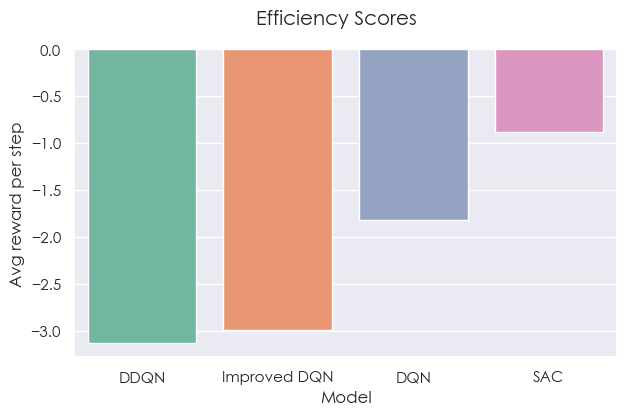

In [84]:
# Sort the DataFrame by 'Avg_Reward_Per_Episode' in ascending order
df = df.sort_values(by='avg_reward_per_step', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Efficiency Scores")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='avg_reward_per_step',
    x=df.index,  # Swap x and y axes
    ax=ax,
    palette=sns.color_palette('Set2')
)

# ax.legend()
ax.set_ylabel('Avg reward per step')
ax.set_xlabel('Model')

plt.show()

### HYPERPARAMETER TUNING OF MODELS

- Based on our earlier results, we will be exploring hyperparameter tuning methods for `Soft Actor-Critic Model` and see if we are able to further improve the performances of our best performing model. 

MODIFYING THE SOFT ACTOR-CRITIC MODEL
- Adding the hyperparameters to the `__init__()` function of the class

In [29]:
class SACAgentTuning:
    def __init__(
        self,
        state_dim=3,
        action_dim=1,
        lr_pi=0.001,
        lr_q=0.001,
        gamma=0.98,
        batch_size=200,
        buffer_limit=100000,
        tau=0.005,
        init_alpha=0.01,
        lr_alpha=0.005,
    ):
        self.state_dim = state_dim
        self.action_dim = action_dim
        self.lr_pi = lr_pi
        self.lr_q = lr_q
        self.gamma = gamma
        self.batch_size = batch_size
        self.buffer_limit = buffer_limit
        self.tau = tau
        self.init_alpha = init_alpha
        self.target_entropy = -self.action_dim
        self.lr_alpha = lr_alpha
        self.memory = ReplayBuffer(self.buffer_limit)
        self.log_alpha = torch.tensor(np.log(self.init_alpha))
        self.log_alpha.requires_grad = True
        self.log_alpha_optimizer = optim.Adam([self.log_alpha], lr=self.lr_alpha)

        self.PI = PolicyNetwork(self.state_dim, self.action_dim, self.lr_pi)
        self.Q1 = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q1_target = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q2 = QNetwork(self.state_dim, self.action_dim, self.lr_q)
        self.Q2_target = QNetwork(self.state_dim, self.action_dim, self.lr_q)

        self.Q1_target.load_state_dict(self.Q1.state_dict())
        self.Q2_target.load_state_dict(self.Q2.state_dict())

    def choose_action(self, s):
        with torch.no_grad():
            action, log_prob = self.PI.sample(s)
        return action, log_prob

    def calc_target(self, mini_batch):
        s, a, r, s_prime, done = mini_batch
        with torch.no_grad():
            a_prime, log_prob_prime = self.PI.sample(s_prime)
            entropy = - self.log_alpha.exp() * log_prob_prime
            q1_target, q2_target = self.Q1_target(s_prime, a_prime), self.Q2_target(s_prime, a_prime)
            q_target = torch.min(q1_target, q2_target)
            target = r + self.gamma * done * (q_target + entropy)
        return target

    def train_agent(self):
        mini_batch = self.memory.sample(self.batch_size)
        s_batch, a_batch, r_batch, s_prime_batch, done_batch = mini_batch
        td_target = self.calc_target(mini_batch)

        # Training of Q1
        q1_loss = F.smooth_l1_loss(self.Q1(s_batch, a_batch), td_target)
        self.Q1.optimizer.zero_grad()
        q1_loss.mean().backward()
        self.Q1.optimizer.step()

        # Training of Q2
        q2_loss = F.smooth_l1_loss(self.Q2(s_batch, a_batch), td_target)
        self.Q2.optimizer.zero_grad()
        q2_loss.mean().backward()
        self.Q2.optimizer.step()

        # Training of PI
        a, log_prob = self.PI.sample(s_batch)
        entropy = -self.log_alpha.exp() * log_prob
        q1, q2 = self.Q1(s_batch, a), self.Q2(s_batch, a)
        q = torch.min(q1, q2)
        pi_loss = -(q + entropy) # For gradient ascent
        self.PI.optimizer.zero_grad()
        pi_loss.mean().backward()
        self.PI.optimizer.step()

        # Alpha train
        self.log_alpha_optimizer.zero_grad()
        alpha_loss = -(self.log_alpha.exp() * (log_prob + self.target_entropy).detach()).mean()
        alpha_loss.backward()
        self.log_alpha_optimizer.step()

        # Soft update of Q1 and Q2
        for param_target, param in zip(self.Q1_target.parameters(), self.Q1.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)
        
        for param_target, param in zip(self.Q2_target.parameters(), self.Q2.parameters()):
            param_target.data.copy_(param_target.data * (1.0 - self.tau) + param.data * self.tau)

HYPERPARAMETER TUNING FUNCTION

In [141]:
def hp_tune_SACAgent(config):
    # Initalize the DQN hp_Agent and related variables required
    hp_agent = SACAgentTuning(**config)
    env = gym.make("Pendulum-v1", g=9.81)
    episodes = 800
    total_rewards = []
    no_of_steps = []
    success_count = 0
    best_reward = float('-inf')

    # Get hypertuning checkpoint
    if train.get_checkpoint():
        loaded_checkpoint = train.get_checkpoint()
        with loaded_checkpoint.as_directory() as loaded_checkpoint_dir:
            model_state = torch.load(
                os.path.join(loaded_checkpoint_dir, "checkpoint.pt")
            )
            hp_agent.load_state_dict(model_state)

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        counter = 0

        while not done:
            counter += 1
            action, log_prob = hp_agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([action])
            hp_agent.memory.put((state, action, reward, state_prime, done))
            score += reward
            state = state_prime

            if hp_agent.memory.size() > 1000:
                hp_agent.train_agent()

        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200
        total_rewards.append(score)
        no_of_steps.append(counter)

        if score > best_reward:
            best_reward = score

        # Saving Checkpoint
        metrics = {
            "avg_reward": np.mean(total_rewards),
        }
        with tempfile.TemporaryDirectory() as tempdir:
            torch.save(
                hp_agent.PI.state_dict(),
                os.path.join(tempdir, "checkpoint.pt"),
            )
            train.report(metrics=metrics, checkpoint=Checkpoint.from_directory(tempdir))

    env.close()

RUNNING HYPERPARAMETER TUNING
- Search space defined is a reasonable range of values where the best results should occur
- We are using `ASHAScheduler` which is an alias to `AsyncHyperBandScheduler`. It is a scheduler used for hyperparameter optimization in distributed machine learning and neural architecture search (NAS). It efficiently manages multiple trials with different hyperparameter configurations, uses early stopping, and is designed for parallel and asynchronous execution, making it useful for finding optimal hyperparameters while utilizing multiple computing resources.

In [143]:
search_space = {
    "state_dim": 3,  # Fixed for the environment
    "action_dim": 1,          # Example choices for action_dim
    "lr_pi": tune.loguniform(1e-4, 0.1),          # Loguniform search for lr_pi
    "lr_q": tune.loguniform(1e-4, 0.1),           # Loguniform search for lr_q
    "gamma": tune.choice([0.95, 0.98, 0.99]),    # choices for gamma
    "batch_size": tune.choice([100, 200, 300]),   # choices for batch_size
    "buffer_limit": tune.choice([50000, 100000, 200000]), # Choices for buffer_limit
    "tau": tune.uniform(0.001, 0.01),            # Uniform search for tau
    "init_alpha": tune.loguniform(1e-4, 0.1),    # Loguniform search for init_alpha
    "lr_alpha": tune.loguniform(1e-4, 0.1),      # Loguniform search for lr_alpha
}

scheduler = ASHAScheduler(
    max_t=800,
    grace_period=1,
    reduction_factor=2
)
    
tuner = tune.Tuner(
    tune.with_resources(
        tune.with_parameters(hp_tune_SACAgent),
        resources={"cpu": 2}
    ),
    tune_config=tune.TuneConfig(
        metric="avg_reward",
        mode="max",
        scheduler=scheduler,
        num_samples=10,
    ),
    param_space=search_space,
)
results = tuner.fit()
    
best_trial = results.get_best_result("avg_reward", "max")
print(f"Best trial config: {best_trial.config}")
print(f"Best trial final average reward: {best_trial.metrics['avg_reward']}")

(hp_tune_SACAgent pid=22804) c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\gym\core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
(hp_tune_SACAgent pid=22804)   deprecation(
(hp_tune_SACAgent pid=22804) c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\gym\wrappers\step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
(hp_tune_SACAgent pid=22804)   deprecation(
(hp_tune_SACAgent pid=22804) c:\Users\zzhen\anaconda3\envs\gpu_env\lib\site-packages\numpy\core\fromnumeric.py:43: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__arra

Best trial config: {'state_dim': 3, 'action_dim': 1, 'lr_pi': 0.0003887437422389239, 'lr_q': 0.006588627430399412, 'gamma': 0.99, 'batch_size': 200, 'buffer_limit': 200000, 'tau': 0.008094487127446998, 'init_alpha': 0.03470881719479883, 'lr_alpha': 0.015397298925206759}
Best trial final total reward: -169.30299748599347


BEST MODEL AFTER TUNING

In [ ]:
best_hp_agent = SACAgentTuning(**best_trial.config)

EVALUATING HYPERTUNED MODEL
1. Retrain the SAC model with the best configuration

In [145]:
def train_best_SACAgent(best_hp_agent:SACAgentTuning):
    # Initalize the SAC Agent and related variables required
    agent = best_hp_agent
    env = gym.make('Pendulum-v1', g=9.81)
    episodes = 800
    total_rewards = []
    no_of_steps = []
    success_count = 0
    frames = []
    best_episode = 0 
    best_reward = float('-inf')

    # Loop through the range of episodes
    for episode in range(episodes):
        state = env.reset()
        score, done = 0.0, False
        start_time = datetime.datetime.now()
        counter = 0
        
        while not done:
            counter += 1
            action, log_prob = agent.choose_action(torch.FloatTensor(state))
            state_prime, reward, done, _ = env.step([action])
            agent.memory.put((state, action, reward, state_prime, done))

            score += reward
            state = state_prime

            if counter % 50 == 0 and score > -50:
                screen = env.render(mode='rgb_array')
                frames.append(screen)

            if agent.memory.size() > 1000: 
                agent.train_agent()

        # Recording results
        if len(total_rewards) > 0:
            success_count += (score - total_rewards[-1]) >= 200 or score > -2
        total_rewards.append(score)
        no_of_steps.append(counter)
        
        if score > best_reward:
            best_reward = score
            best_episode = episode
            
        # Saving the Models
        save_folder = "Tuned_SAC"
        if not os.path.exists(save_folder):
            os.makedirs(save_folder)

        if episode == best_episode:
            model_name = os.path.join(save_folder, "Tuned_SAC" + str(episode) + ".pt")
            torch.save(agent.PI.state_dict(), model_name)
            
        if episode % 10 == 0:
            elapsed_time = datetime.datetime.now() - start_time
            print('Episode {:>4} | Total Reward: {:>8.2f} | Elapsed: {}'.format(episode, score, elapsed_time))   
    
    env.close()

    return {
        'total_rewards': total_rewards,
        'no_of_steps': no_of_steps,
        'success_count': success_count,
        'frames': frames
    }

tuned_SAC_results = train_best_SACAgent(best_hp_agent)

Episode    0 | Total Reward:  -887.64 | Elapsed: 0:00:00.055890


Episode   10 | Total Reward:  -665.24 | Elapsed: 0:00:02.148514
Episode   20 | Total Reward:  -131.11 | Elapsed: 0:00:01.387094
Episode   30 | Total Reward:  -370.03 | Elapsed: 0:00:01.326462
Episode   40 | Total Reward:  -234.36 | Elapsed: 0:00:01.342169
Episode   50 | Total Reward:  -120.40 | Elapsed: 0:00:01.368868
Episode   60 | Total Reward:    -1.85 | Elapsed: 0:00:01.395959
Episode   70 | Total Reward:  -122.71 | Elapsed: 0:00:01.352037
Episode   80 | Total Reward:  -126.02 | Elapsed: 0:00:01.462505
Episode   90 | Total Reward:  -121.53 | Elapsed: 0:00:01.382721
Episode  100 | Total Reward:  -237.28 | Elapsed: 0:00:01.378617
Episode  110 | Total Reward:  -356.86 | Elapsed: 0:00:01.403869
Episode  120 | Total Reward:  -126.44 | Elapsed: 0:00:01.356247
Episode  130 | Total Reward:  -130.07 | Elapsed: 0:00:01.407759
Episode  140 | Total Reward:  -245.72 | Elapsed: 0:00:01.416777
Episode  150 | Total Reward:  -229.19 | Elapsed: 0:00:01.447425
Episode  160 | Total Reward:  -117.94 | 

Performance Statistics for the SAC Model:
--------------------------------------------
Best Episode   : 789
Average Reward : -168.98
Median Reward  : -125.16
Maximum Reward : -0.24
Minimum Reward : -1604.26


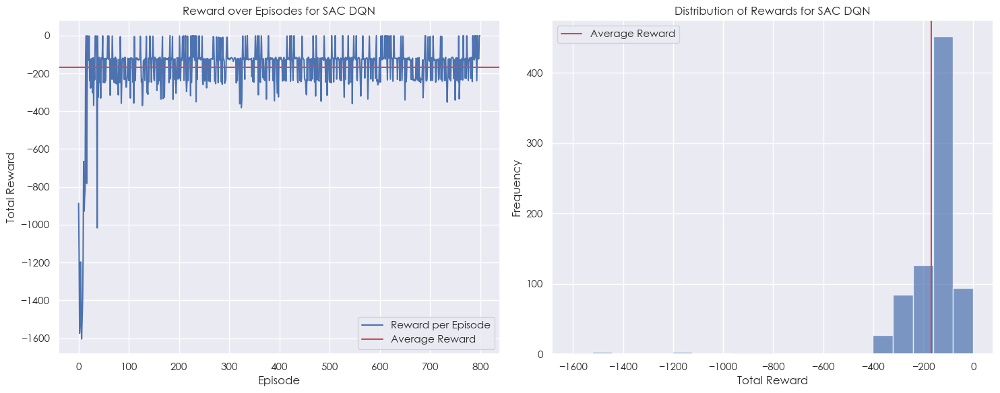

In [146]:
# Calculating statistical measures
average_reward = np.mean(tuned_SAC_results['total_rewards'])
median_reward = np.median(tuned_SAC_results['total_rewards'])
max_reward = np.max(tuned_SAC_results['total_rewards'])
min_reward = np.min(tuned_SAC_results['total_rewards'])

# Identifying the best episode
best_episode_index = np.argmax(tuned_SAC_results['total_rewards']) 

# Printing the Statistics
print("Performance Statistics for the SAC Model:")
print("--------------------------------------------")
print(f"Best Episode   : {best_episode_index}")
print(f"Average Reward : {average_reward:.2f}")
print(f"Median Reward  : {median_reward:.2f}")
print(f"Maximum Reward : {max_reward:.2f}")
print(f"Minimum Reward : {min_reward:.2f}")

# Plot the charts to show performance over time
plot_agent_performance(tuned_SAC_results['total_rewards'], average_reward, model_name="SAC DQN")

**TESTING OUR MODEL WEIGHTS**
- There is no training involved
- It is to see if the saved model weights can keep the pendulum inverted

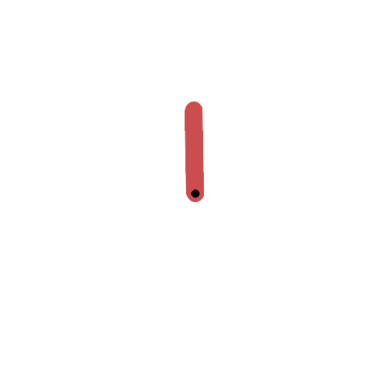

In [31]:
config = {
    "state_dim": 3,
    "action_dim": 1,
    "lr_pi": 0.0003887437422389239,
    "lr_q": 0.006588627430399412,
    "gamma": 0.99,
    "batch_size": 200,
    "buffer_limit": 200000,
    "tau": 0.008094487127446998,
    "init_alpha": 0.03470881719479883,
    "lr_alpha": 0.015397298925206759,
}

agent = SACAgentTuning(**config)
agent.PI.load_state_dict(torch.load('./Tuned_SAC/Tuned_SAC789.pt'))

test_agent(agent, 'SAC')

**MODEL TRAINING EVOLUTION**
- Visualize how the model has improved over each episode

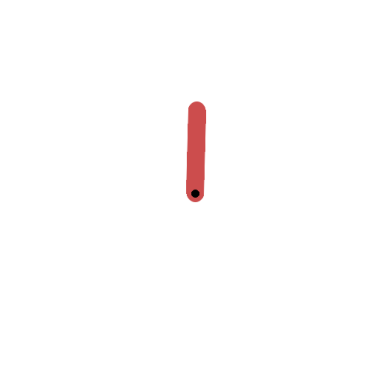

In [154]:
# Visualizing the pendulum's animation
create_animation(tuned_SAC_results['frames']) # Visualizing the pendulum's animation

### HYPERTUNED MODEL EVALUATION

We will be evaluating the hypertuned SAC model with the rest of the models with the same metrics we did earlier to understand if the tuned model indeed performed better.

#### AVERAGE REWARD BAR PLOT

In [155]:
tuned_SAC_metrics = MetricsCalculator(**tuned_SAC_results, n_episodes=800)

all_avg_reward_per_episode = {
    'DQN': DQN_metrics.avg_reward_per_episode(),
    'Improved DQN': ImprovedDQN_metrics.avg_reward_per_episode(),
    'DDQN': DDQN_metrics.avg_reward_per_episode(),
    'SAC': SAC_metrics.avg_reward_per_episode(),
    'Tuned SAC': tuned_SAC_metrics.avg_reward_per_episode(),
}

df = create_dataframe_from_dict(all_avg_reward_per_episode, 'Avg_Reward_Per_Episode')
df

,Avg_Reward_Per_Episode
DQN,-340.944229
Improved DQN,-545.086096
DDQN,-569.351038
SAC,-176.178789
Tuned SAC,-168.979288


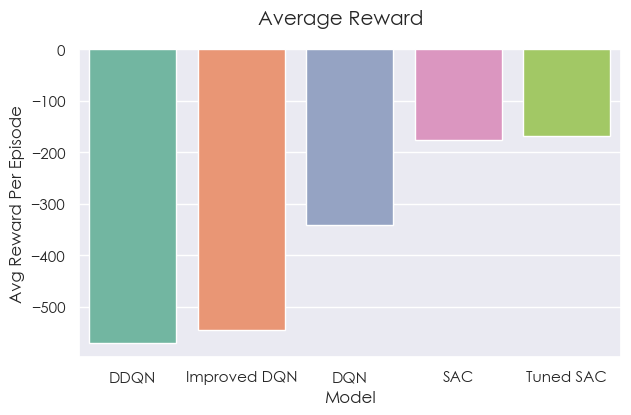

In [156]:
# Sort the DataFrame by 'Avg_Reward_Per_Episode' in ascending order
df = df.sort_values(by='Avg_Reward_Per_Episode', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Average Reward")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='Avg_Reward_Per_Episode',
    x=df.index,
    ax=ax,
    palette=sns.color_palette('Set2')
)

# ax.legend()
ax.set_ylabel('Avg Reward Per Episode') 
ax.set_xlabel('Model')  

plt.show()

#### SUCCESS RATE

In [162]:
all_success_rate = {
    'DQN': DQN_metrics.success_rate(),
    'Improved DQN': ImprovedDQN_metrics.success_rate(),
    'DDQN': DDQN_metrics.success_rate(),
    'SAC': SAC_metrics.success_rate(),
    'Tuned SAC': tuned_SAC_metrics.success_rate(),
}

# Convert the dictionary to a DataFrame
df = create_dataframe_from_dict(all_success_rate, 'success_rate')
df

,success_rate
DQN,0.2450
Improved DQN,0.1525
DDQN,0.1575
SAC,0.0725
Tuned SAC,0.1100


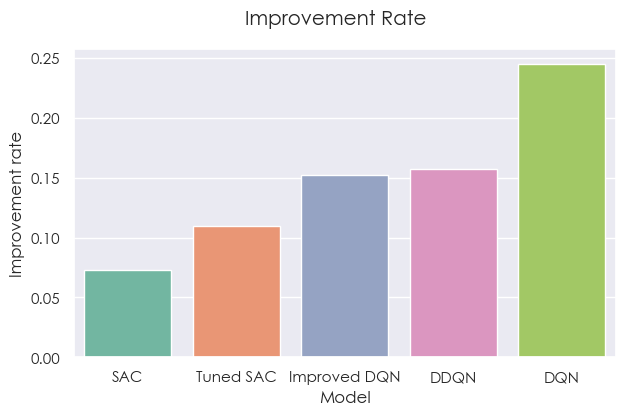

In [165]:
# Sort the DataFrame by 'success_rate' in ascending order
df = df.sort_values(by='success_rate', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Improvement Rate")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='success_rate',
    x=df.index,  # Swap x and y axes
    ax=ax,
    palette=sns.color_palette('Set2')
)

ax.set_ylabel('Improvement rate') 
ax.set_xlabel('Model') 

plt.show()

### Model Efficiency

In [159]:
all_avg_reward_per_step = {
    'DQN': DQN_metrics.avg_reward_per_step(),
    'Improved DQN': ImprovedDQN_metrics.avg_reward_per_step(),
    'DDQN': DDQN_metrics.avg_reward_per_step(),
    'SAC': SAC_metrics.avg_reward_per_step(),
    'Tuned SAC': tuned_SAC_metrics.avg_reward_per_step(),
}

# Convert the dictionary to a DataFrame
df = create_dataframe_from_dict(all_avg_reward_per_step, 'avg_reward_per_step')

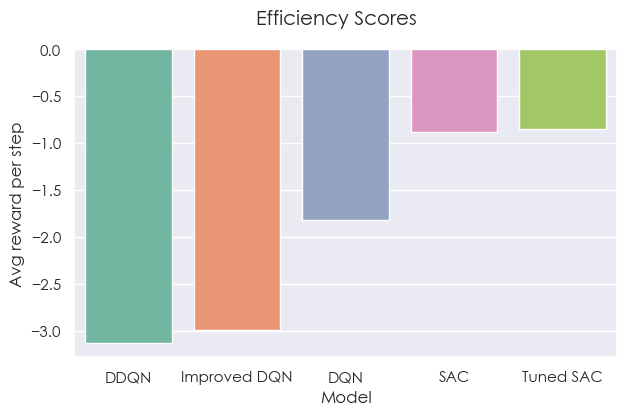

In [160]:
# Sort the DataFrame by 'Avg_Reward_Per_Episode' in ascending order
df = df.sort_values(by='avg_reward_per_step', ascending=True)

fig = plt.figure(figsize=(7, 4))
fig.suptitle(f"Efficiency Scores")
ax = fig.subplots()
sns.barplot(
    data=df,
    y='avg_reward_per_step',
    x=df.index,  # Swap x and y axes
    ax=ax,
    palette=sns.color_palette('Set2')
)

# ax.legend()
ax.set_ylabel('Avg reward per step')
ax.set_xlabel('Model')

plt.show()

### CONCLUSION OF PENDULUM REINFORCEMENT LEARNING

Reinforcement learning is a powerful and promising field in the area of Artificial Intelligence. With its ability to learn through trial and error and make decisions in dynamic environments, it has been successfully applied to various problems, ranging from gaming to robotics. Pendulum is a classic example of how reinforcement learning can be used to solve classic control problems in a simulated environment.

We have successfully tackled the Pendulum problem through the use of Reinforcement Learning algorithms, namely DQN, DDQN and SAC. Through this project, we have evaluated the models on various aspects such as performance, efficiency, robustness and feature importance. Our findings have provided valuable insights into the behavior of the algorithms and the intricacies of Reinforcement Learning. 

This project has been a challenging yet enlightening experience and has helped us to gain a deeper understanding of Reinforcement Learning concepts. We hope that our work can contribute to the development of more advanced Reinforcement Learning models in the future.